# Social Network Analysis Project 3

In [197]:
# install necessary library
!pip install spotipy

In [198]:
# import necessary libraries
import spotipy
from spotipy.oauth2 import SpotifyOAuth
import spotipy.util as util
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from networkx.algorithms.community import girvan_newman
from networkx.algorithms.community.quality import modularity
from networkx.algorithms.community import kernighan_lin_bisection
import plotly.graph_objs as go
import plotly.offline as pyo

## My Top Artists

### Mapping Social Network from Spotify

In [200]:
def get_my_top_artists(sp, limit=100, time_range='medium_term'):
  """
  Fetch top artists from a user's Spotify listening history over a specified time range.

  Parameters:
  - sp (Spotify client): The authenticated Spotify client.
  - limit (int): The maximum number of top artists to return.
  - time_range (str): The time range over which the top artists are calculated
    ('short_term', 'medium_term', 'long_term')

  Returns:
  - list: A list of dictionaries, each containing details of a top artist.
  """
  # Initialize an empty list to store artist information.
  artist_data = []

  # Calculate the number of requests needed (each request can retrieve a maximum of 50 artists)
  # Ensures we round up if not a multiple of 50
  num_requests = (limit + 49) // 50

  for i in range(num_requests):
    offset = i * 50
    # Adjust limit for the last request
    current_limit = min(50, limit - offset)

    # Fetch the user's top artists using the Spotify client
    results = sp.current_user_top_artists(limit=current_limit, time_range=time_range, offset=offset)
    artists = results['items']

    for artist in artists:
      # Store essential details about each artist in a dictionary
      artist_info = {
        'Name': artist['name'],
        'ID': artist['id'],
        'Popularity': artist['popularity'],
        'Genres': ', '.join(artist['genres']),
        'Followers': artist['followers']['total']
      }
      # Append the artist info to the list of artist data
      artist_data.append(artist_info)
  return artist_data

# Spotify Developer credentials
client_id = '81506b6cadef41c8b2a69789691df64a'
client_secret = 'b62fe60e3b4741e9be211db3543d92a5'
redirect_uri = 'http://localhost:8888/callback'

# Set up the OAuth object with necessary details including the scope and redirect URI
# 'user-top-read' scope allows access to the user's top played tracks and artists
auth_manager = SpotifyOAuth(client_id=client_id,
                            client_secret=client_secret,
                            redirect_uri=redirect_uri,
                            scope='user-top-read',
                            show_dialog=True)

# Get the authorization URL
auth_url = auth_manager.get_authorize_url()
print("Please navigate to the following URL to authorize:", auth_url)

# Ask the user to enter the full redirect URL after they authorize the app
response_url = input("Paste the full redirect URL here:")

# Retrieve the token using the response URL
token_info = auth_manager.get_access_token(response_url, as_dict=False)

# Check if we successfully obtained an access token
if token_info:
  #Create a Spotify client with the authorized token
    sp = spotipy.Spotify(auth_manager=auth_manager)
    print("Authentication successful")

    # Fetch the top 200 artists
    my_top_artists = get_my_top_artists(sp, limit=200, time_range='long_term')
    print('Done')
else:
    print("Failed to retrieve token.")

Please navigate to the following URL to authorize: https://accounts.spotify.com/authorize?client_id=81506b6cadef41c8b2a69789691df64a&response_type=code&redirect_uri=http%3A%2F%2Flocalhost%3A8888%2Fcallback&scope=user-top-read&show_dialog=True
Paste the full redirect URL here:AQCrFj4izV1ei9AQtmURCEGILr5NvSrSXIGylIz84H53N1STWj3XFCzNSCGvqbC0U4VbK2nGq5TRYZePXnC96B2wTpXAZQdskH2GTU_kdAac2f6Lhk9_qEClabjsDsTJJ1CGWGecbbtdIMewlqzqrSwXPiqihqh14iic55ZB0ax0P2_ErwKYzHyt1tgWBuWsSA
Authentication successful
Done


In [159]:
# Convert list into a DataFrame
df_my_top_artists = pd.DataFrame(my_top_artists)
df_my_top_artists

,Name,ID,Popularity,Genres,Followers
0,Taylor Swift,06HL4z0CvFAxyc27GXpf02,100,pop,116743470
1,ROSALÍA,7ltDVBr6mKbRvohxheJ9h1,78,"pop, r&b en espanol",8192276
2,Hozier,2FXC3k01G6Gw61bmprjgqS,85,"irish singer-songwriter, modern rock, pop, pov...",7498311
3,Charli xcx,25uiPmTg16RbhZWAqwLBy5,86,"art pop, candy pop, metropopolis, pop, uk pop",3601246
4,Lana Del Rey,00FQb4jTyendYWaN8pK0wa,91,"art pop, pop",37525788
...,...,...,...,...,...
195,Sevdaliza,5MraexJKZDrQYzS98kNwie,77,"alternative r&b, persian electronic",611287
196,Aaron Tveit,68h2f0WXn4zEctSgNYozXx,53,"broadway, hollywood, show tunes",46079
197,Kesha,6LqNN22kT3074XbTVUrhzX,79,"dance pop, pop",8051627
198,Chris Brown,7bXgB6jMjp9ATFy66eO08Z,87,"r&b, rap",22486464


In [ ]:
# Save the DataFrame
df_my_top_artists.to_csv('my_top_artists.csv', index=False)

In [160]:
def get_collaborations(artists_df, country):
  """
  Identifies collaborations among a list of artists based on their top tracks in a specific country.

  Parameters:
  - artists_df (DataFrame): A Dataframe containing artist IDs and names.
  - country (str): The country code to filter the Spotify market.

  Returns:
  - list: A list of dictionaries, each containing details about a collaborative track.
  """
  # Initialize an empty list to store collaboration details.
  collaborations = []

  # Convert the DataFrame column 'ID' into a dictionary with 'Name' as values for easy access
  artist_ids = pd.Series(artists_df['Name'].values, index=artists_df['ID']).to_dict()

  # Iterate over each artist in the DataFrame
  for index, artist in artists_df.iterrows():
    # Retrieve the top tracks of the artist in the specified market.
    results = sp.artist_top_tracks(artist['ID'], country=country)

    # Loop through each track in the top tracks of the artist
    for track in results['tracks']:
      # Extract the IDs of all artists involved in the track.
      track_artists = [a['id'] for a in track['artists']]

      # Find common artists between track artists and list of top artists
      common_artists = set(track_artists).intersection(artist_ids.keys())

      # Check if there are collaborations (more than one top artist on the track)
      if len(common_artists) > 1:
        # Collect details of the collaborative track
        collaboration_info = {
          'Track Name': track['name'],
          'Artists': ', '.join([artist_ids[aid] for aid in common_artists]),
          'Track URL': track['external_urls']['spotify']  # URL to the track on Spotify
        }
        # Append the collaboration info to the list.
        collaborations.append(collaboration_info)

  # Return the list of collaborations.
  return collaborations

# Use the function to find collaborations among the top artists.
collaborations = get_collaborations(df_my_top_artists, 'US')

In [161]:
# Convert the list of collaborations into a DataFrame for better visualization and analysis.
df_collaborations = pd.DataFrame(collaborations)
df_collaborations

,Track Name,Artists,Track URL
0,BESO,"ROSALÍA, Rauw Alejandro",https://open.spotify.com/track/609E1JCInJncact...
1,LA NOCHE DE ANOCHE,"Bad Bunny, ROSALÍA",https://open.spotify.com/track/2XIc1pqjXV3Cr2B...
2,LA FAMA,"ROSALÍA, The Weeknd",https://open.spotify.com/track/6Y46tOTRhkBamos...
3,TKN (feat. Travis Scott),"Travis Scott, ROSALÍA",https://open.spotify.com/track/4w47S36wQGBhGg0...
4,"The girl, so confusing version with lorde","Lorde, Charli xcx",https://open.spotify.com/track/2YFhqZvhTpyK13g...
...,...,...,...
219,The Boom - From the Paramount+ Series ‘Grease:...,"Ari Notartomaso, Marisa Davila",https://open.spotify.com/track/773TFoW66BW1lTM...
220,Good Girl Act - From the Paramount+ Series ‘Gr...,"Ari Notartomaso, Marisa Davila",https://open.spotify.com/track/2YdRc2Uqc0MQdmo...
221,Pointing Fingers - From the Paramount+ Series ...,"Ari Notartomaso, Marisa Davila",https://open.spotify.com/track/35750OBJrFWrt6m...
222,Think Pink - From the Paramount+ Series ‘Greas...,"Ari Notartomaso, Marisa Davila",https://open.spotify.com/track/02kTyoyjJpZkPdF...


In [162]:
# Save the DataFrame
df_collaborations.to_csv('collaborations_my_top_artists.csv', index=False)

### Visualization of the Social Network

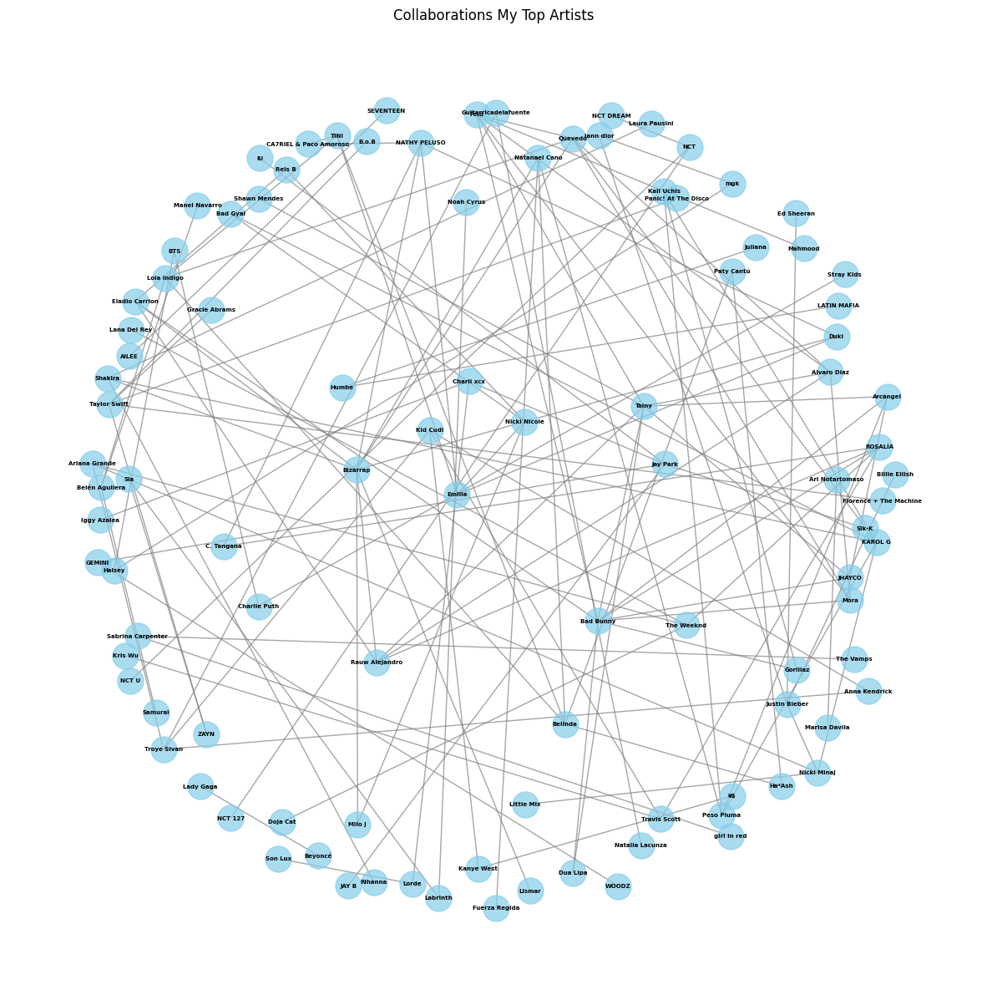

In [177]:
def create_collaboration_graph(df_collaborations):
  """
  Creates a graph from a DataFrame of artist collaborations and visualizes it.

  Parameters:
  - df_collaborations (DataFrame): A DataFrame where each row represents a
    collaborative track with an 'Artists' column containing a comma-separated
    string of artist names.

  Returns:
  - nx.Graph: The graph object representing artist collaborations.
  """
  # Initialize a new undirected graph.
  G = nx.Graph()

  # Iterate over each row in the DataFrame to add edges to the graph based on collaborations.
  for _, row in df_collaborations.iterrows():
    # Convert the string of artist names into a list of individual artists.
    artists = row['Artists'].split(', ')
    # Add an edge for each pair of artists in this collaboration.
    for i in range(len(artists)):
      for j in range(i + 1, len(artists)):
        # Add an edge with the track name as an attribute.
        G.add_edge(artists[i], artists[j])

  # Visualize the graph.
  plt.figure(figsize=(15, 15)) # Define the size of the plot.
  pos = nx.spring_layout(G, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
  nx.draw_networkx_nodes(G, pos, node_size=500, node_color='skyblue', alpha=0.7)  # Draw nodes in sky blue.
  nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw edges in gray.
  nx.draw_networkx_labels(G, pos, font_size=5, font_weight='bold')  # Add labels to the nodes (artist names).

  plt.title("Collaborations My Top Artists")  # Set the title of the plot.
  plt.axis('off')  # Turn off the axis as they are not relevant.
  plt.show()  # Display the plot.
  return G

# Create and plot the graph based on the DataFrame 'df_collaborations'
G = create_collaboration_graph(df_collaborations)

### Basic Characteristics of the Network

In [178]:
# Determine the type of the graph
graph_type = {
    'is_bipartite': nx.is_bipartite(G),
    'is_directed': nx.is_directed(G),
    'is_undirected': not nx.is_directed(G),
    'is_planar': nx.check_planarity(G)[0]
}

# Print the results
for classification, result in graph_type.items():
    print(f"{classification}: {result}")

# Additional properties can be checked if needed
is_connected = nx.is_connected(G) if not nx.is_directed(G) else nx.is_weakly_connected(G)
print(f"is_connected: {is_connected}")

is_bipartite: False
is_directed: False
is_undirected: True
is_planar: False
is_connected: False


In [179]:
nx.average_clustering(G)

0.11188118811881187

In [180]:
# Check if the graph is connected
if nx.is_connected(G):
    # Calculate key network metrics if the graph is fully connected
    avg_path_length = nx.average_shortest_path_length(G)  # Average number of steps along the shortest paths for all possible pairs of network nodes
    clustering_coefficient = nx.average_clustering(G)  # Measure of the degree to which nodes in a graph tend to cluster together
    diameter = nx.diameter(G)  # The largest number of vertices that must be traversed in order to travel from one vertex to another
    eccentricity = nx.eccentricity(G)  # The maximum distance from a node to all other nodes in the graph
    radius = nx.radius(G)  # The minimum eccentricity among the vertices
    periphery = nx.periphery(G)  # Set of nodes that have eccentricity equal to the diameter
    center = nx.center(G)  # Set of nodes that have eccentricity equal to the radius
else:
    print('Graph is not connected, calculating metrics for largest connected component')
    # Calculate metrics for the largest connected component if the graph is not fully connected
    largest_cc = max(nx.connected_components(G), key=len)  # Find the largest connected component
    G_largest_cc = G.subgraph(largest_cc)  # Create a subgraph of G based on the largest connected component
    # Calculate metrics for the largest connected component
    avg_path_length = nx.average_shortest_path_length(G_largest_cc)
    clustering_coefficient = nx.average_clustering(G_largest_cc)
    diameter = nx.diameter(G_largest_cc)
    eccentricity = nx.eccentricity(G_largest_cc)
    radius = nx.radius(G_largest_cc)
    periphery = nx.periphery(G_largest_cc)
    center = nx.center(G_largest_cc)

# Retrieve the number of nodes and edges in the graph
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()

# Calculate the average distance across the graph (or its largest connected component if not fully connected)
avg_distance = nx.average_shortest_path_length(G_largest_cc) if not nx.is_connected(G) else avg_path_length

# Prepare a dictionary to store all the calculated network characteristics
network_characteristics = {
    'Number of nodes': num_nodes,
    'Number of edges': num_edges,
    'Average path length': avg_path_length,
    'Clustering coefficient': clustering_coefficient,
    'Diameter': diameter,
    'Eccentricity': eccentricity,
    'Radius': radius,
    'Periphery': periphery,
    'Center': center,
    'Average distance': avg_distance
}

# Print each characteristic with its calculated value
for characteristic, value in network_characteristics.items():
    print(f"{characteristic}: {value}")

Graph is not connected, calculating metrics for largest connected component
Number of nodes: 101
Number of edges: 128
Average path length: 4.651282051282052
Clustering coefficient: 0.1712121212121212
Diameter: 12
Eccentricity: {'ROSALÍA': 10, 'Rauw Alejandro': 11, 'Bad Bunny': 11, 'The Weeknd': 9, 'Travis Scott': 11, 'C. Tangana': 11, 'NATHY PELUSO': 11, 'Quevedo': 9, 'Bizarrap': 10, 'Natanael Cano': 10, 'Nicki Nicole': 10, 'Shakira': 9, 'Milo j': 11, 'Feid': 10, 'JHAYCO': 11, 'Mahmood': 11, 'Stray Kids': 12, 'Charlie Puth': 11, 'Belén Aguilera': 11, 'Lola Indigo': 10, 'Samuraï': 12, 'Alvaro Diaz': 10, 'Tainy': 11, 'Mora': 10, 'Kali Uchis': 9, 'Peso Pluma': 9, 'KAROL G': 8, 'Guitarricadelafuente': 10, 'Natalia Lacunza': 11, 'Troye Sivan': 9, 'Belinda': 11, 'Bad Gyal': 9, 'Emilia': 11, 'CA7RIEL & Paco Amoroso': 12, 'Duki': 11, 'Ariana Grande': 8, 'BTS': 10, 'Halsey': 9, 'Rels B': 11, 'Eladio Carrion': 11, 'TINI': 11, 'Dua Lipa': 12, 'Shawn Mendes': 12, 'Arcángel': 10, 'Kid Cudi': 10, 'K

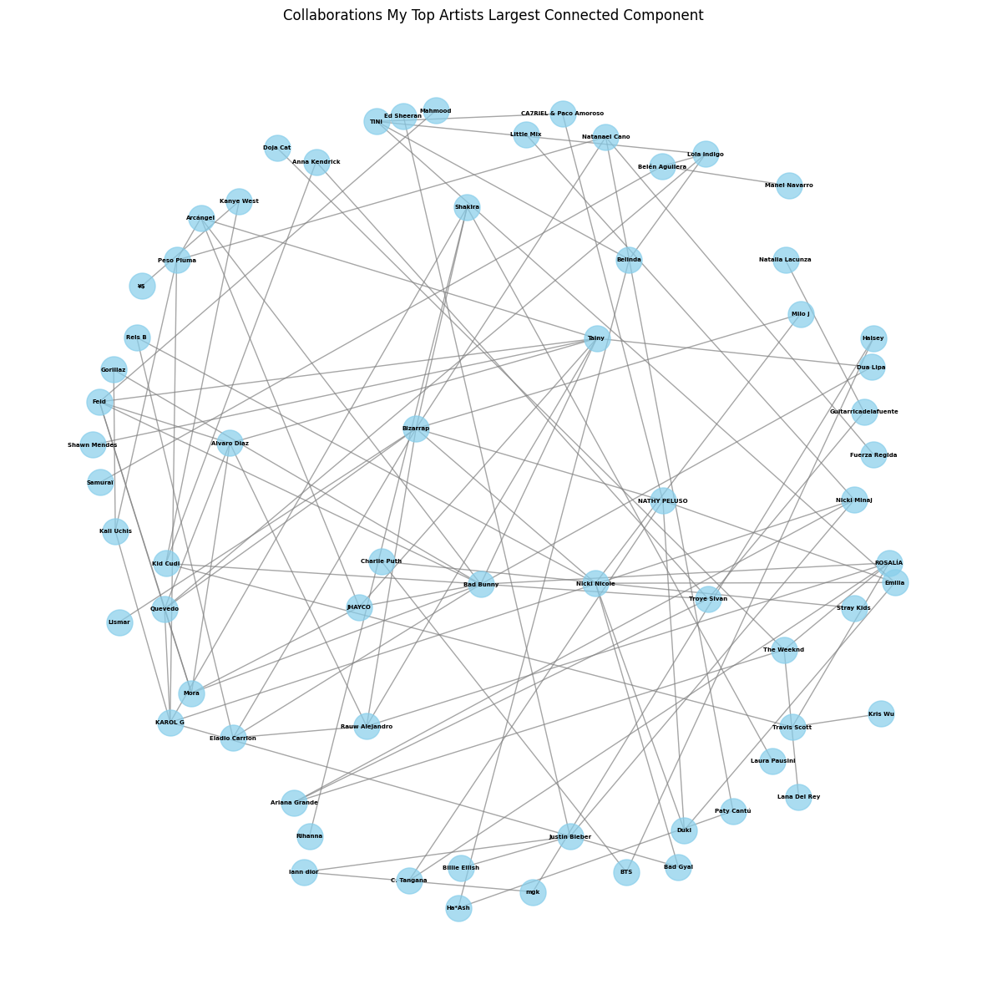

In [181]:
# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G_largest_cc, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G_largest_cc, pos, node_size=500, node_color='skyblue', alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G_largest_cc, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G_largest_cc, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Collaborations My Top Artists Largest Connected Component")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()  # Display the plot.

In [182]:
# Determine the number of nodes and edges
num_nodes = G_largest_cc.number_of_nodes()
num_edges = G_largest_cc.number_of_edges()

# Print the results
print(f"Number of nodes: {num_nodes}")
print(f"Number of edges: {num_edges}")

Number of nodes: 66
Number of edges: 101


<ipython-input-183-1fedf91f64c8>:23: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



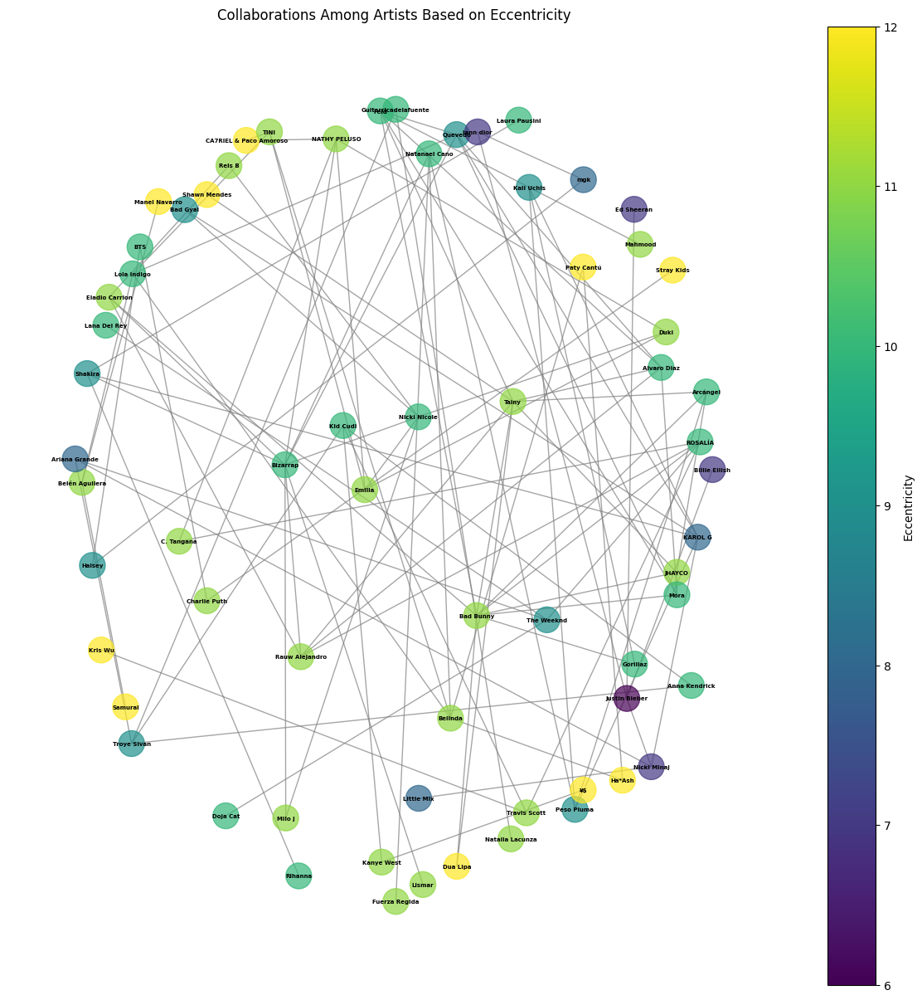

In [183]:
eccentricity = nx.eccentricity(G_largest_cc)

# Create a colormap
cmap = plt.colormaps['viridis']

# Normalize eccentricity for color mapping
norm = mcolors.Normalize(vmin=min(eccentricity.values()), vmax=max(eccentricity.values()))

# Get colors for each node based on eccentricity
node_colors = [cmap(norm(eccentricity[node])) for node in G_largest_cc.nodes()]

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G_largest_cc, pos, node_size=500, node_color=node_colors, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G_largest_cc, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G_largest_cc, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Collaborations Among Artists Based on Eccentricity")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.colorbar(sm, label='Eccentricity')
plt.show()

<ipython-input-184-d679ff9122aa>:23: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



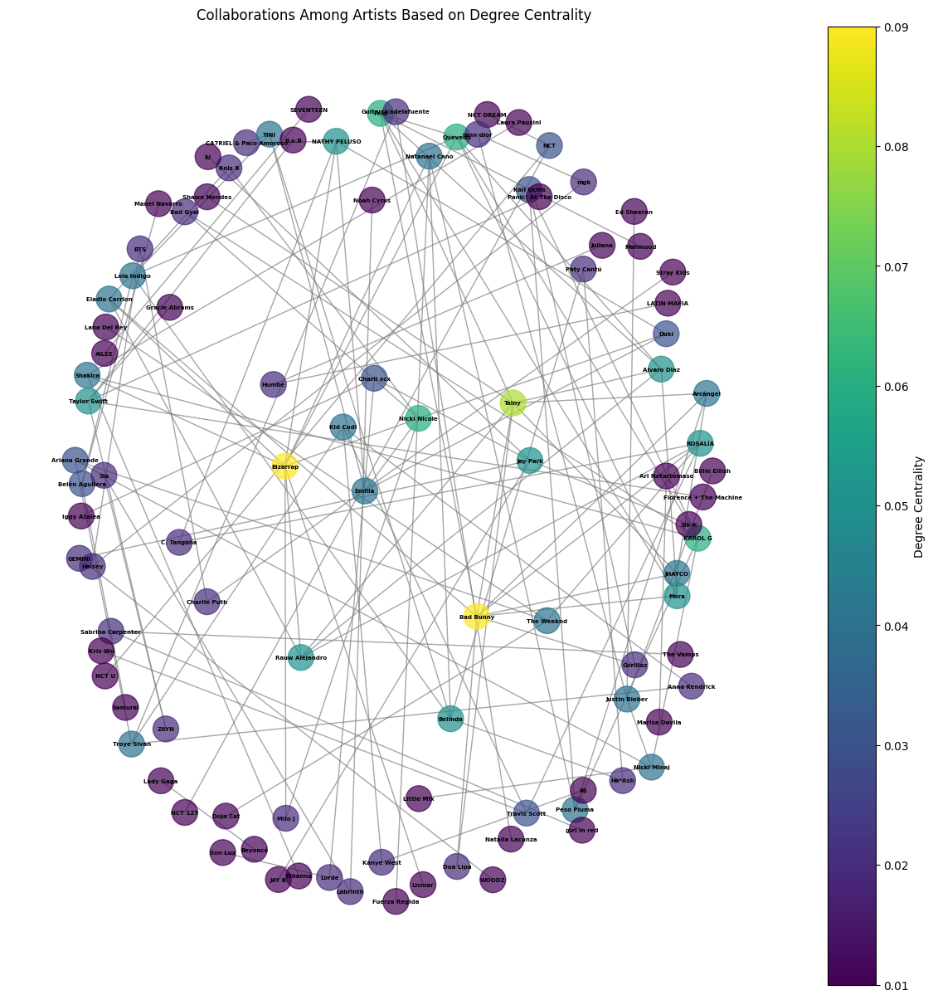

In [184]:
degree_centrality = nx.degree_centrality(G)

# Create a colormap
cmap = plt.colormaps['viridis']

# Normalize eccentricity for color mapping
norm = mcolors.Normalize(vmin=min(degree_centrality.values()), vmax=max(degree_centrality.values()))

# Get colors for each node based on eccentricity
node_colors = [cmap(norm(degree_centrality[node])) for node in G.nodes()]

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Collaborations Among Artists Based on Degree Centrality")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.colorbar(sm, label='Degree Centrality')
plt.show()

In [185]:
# Convert the degree centrality dictionary to a pandas DataFrame
degree_centrality_df = pd.DataFrame.from_dict(degree_centrality, orient='index', columns=['Degree Centrality'])

# Sort the DataFrame by Degree Centrality in descending order
degree_centrality_df = degree_centrality_df.sort_values(by='Degree Centrality', ascending=False)

# Select the top N nodes based on Degree Centrality
top_n = 10  # Change this value to select a different number of top nodes
most_important_nodes = degree_centrality_df.head(top_n)
most_important_nodes

,Degree Centrality
Bad Bunny,0.09
Bizarrap,0.09
Tainy,0.08
Feid,0.06
Quevedo,0.06
Nicki Nicole,0.06
KAROL G,0.06
ROSALÍA,0.05
NATHY PELUSO,0.05
Mora,0.05


In [186]:
# Calculate the average degree centrality
average_degree_centrality = degree_centrality_df['Degree Centrality'].mean()
average_degree_centrality

0.025346534653465338

<ipython-input-187-61c2fc6fc9cf>:23: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



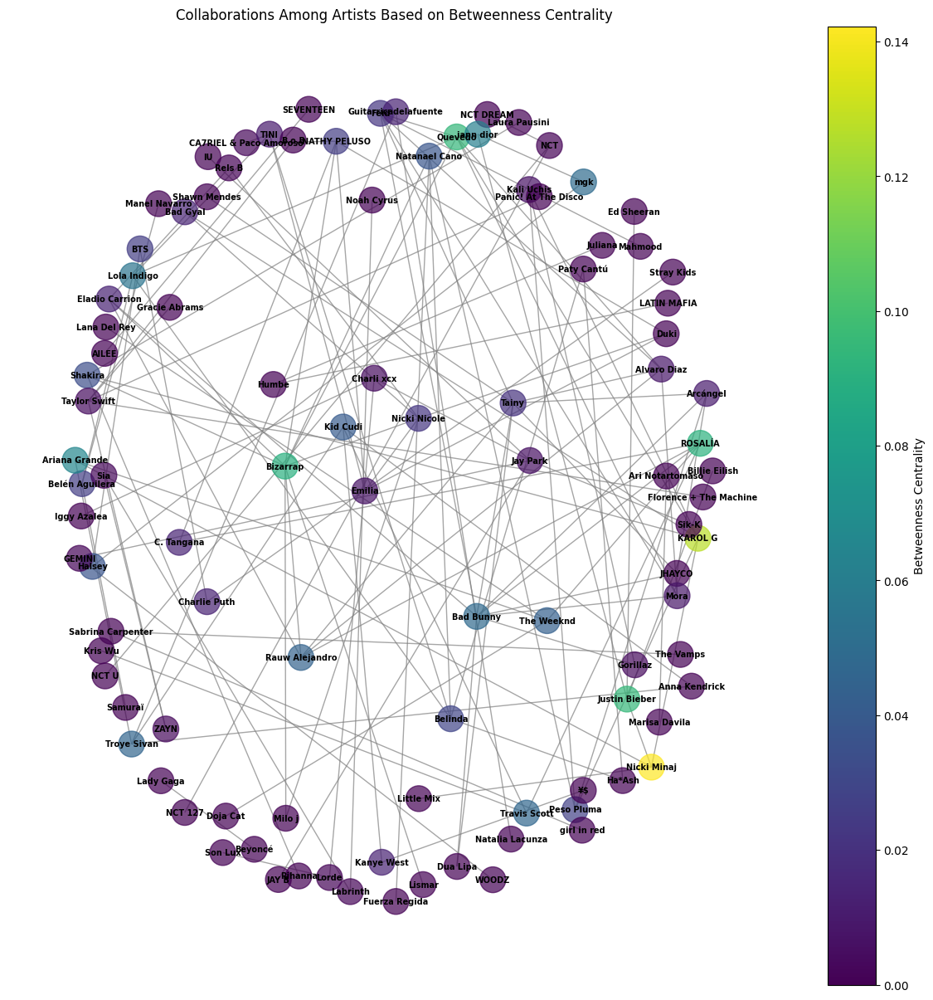

In [187]:
betweenness_centrality = nx.betweenness_centrality(G)

# Create a colormap
cmap = plt.colormaps['viridis']

# Normalize eccentricity for color mapping
norm = mcolors.Normalize(vmin=min(betweenness_centrality.values()), vmax=max(betweenness_centrality.values()))

# Get colors for each node based on eccentricity
node_colors = [cmap(norm(betweenness_centrality[node])) for node in G.nodes()]

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Collaborations Among Artists Based on Betweenness Centrality")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.colorbar(sm, label='Betweenness Centrality')
plt.show()

In [113]:
# Convert the degree centrality dictionary to a pandas DataFrame
betweenness_centrality_df = pd.DataFrame.from_dict(betweenness_centrality, orient='index', columns=['Betweenness Centrality'])

# Sort the DataFrame by Degree Centrality in descending order
betweenness_centrality_df = betweenness_centrality_df.sort_values(by='Betweenness Centrality', ascending=False)

# Select the top N nodes based on Degree Centrality
top_n = 10  # Change this value to select a different number of top nodes
most_important_nodes = betweenness_centrality_df.head(top_n)
most_important_nodes

,Betweenness Centrality
Nicki Minaj,0.142267
KAROL G,0.127323
Justin Bieber,0.094747
Quevedo,0.094267
ROSALÍA,0.090604
Bizarrap,0.090499
Ariana Grande,0.065541
iann dior,0.060606
Lola Indigo,0.054972
mgk,0.049293


In [114]:
# Calculate the average degree centrality
average_betweenness_centrality = betweenness_centrality_df['Betweenness Centrality'].mean()
average_betweenness_centrality

0.01591759175917592

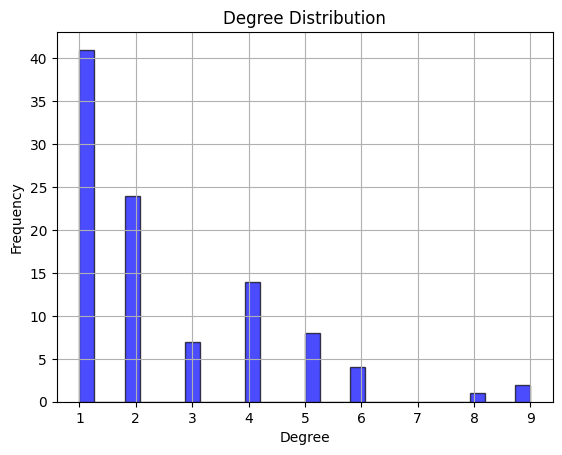

In [115]:
# Calculate the degree of each node
degrees = dict(G.degree())

# Extract degree values
degree_values = list(degrees.values())

# Plotting the histogram of node degrees
plt.hist(degree_values, bins=30, alpha=0.7, color='blue', edgecolor='black')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.title('Degree Distribution')
plt.grid(True)
plt.show()

Modularity: 0.578887939453125


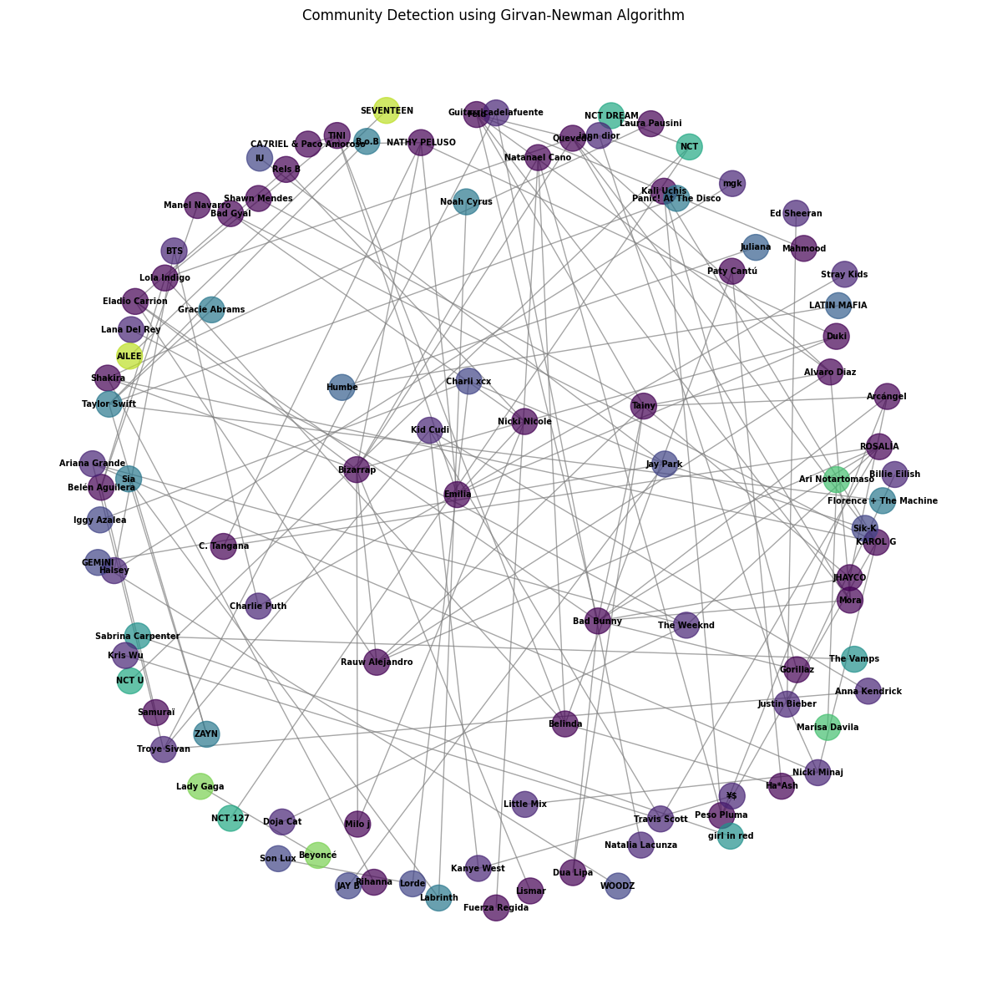

In [188]:
# Use the Girvan-Newman algorithm to detect communities
comp = girvan_newman(G)
# Select the first level of community divisions
communities = next(comp)
communities = [list(community) for community in communities]

# Evaluate the community detection using modularity
modularity_value = modularity(G, communities)

# Print the modularity value
print(f"Modularity: {modularity_value}")

# Create a colormap
cmap = plt.colormaps['viridis']
colors = [cmap(i / len(communities)) for i in range(len(communities))]

# Assign colors to nodes based on their community
color_map = []
for node in G:
    for i, community in enumerate(communities):
        if node in community:
            color_map.append(colors[i % len(colors)])

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G, pos, node_size=500, node_color=color_map, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Community Detection using Girvan-Newman Algorithm")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

Modularity: 0.418670654296875


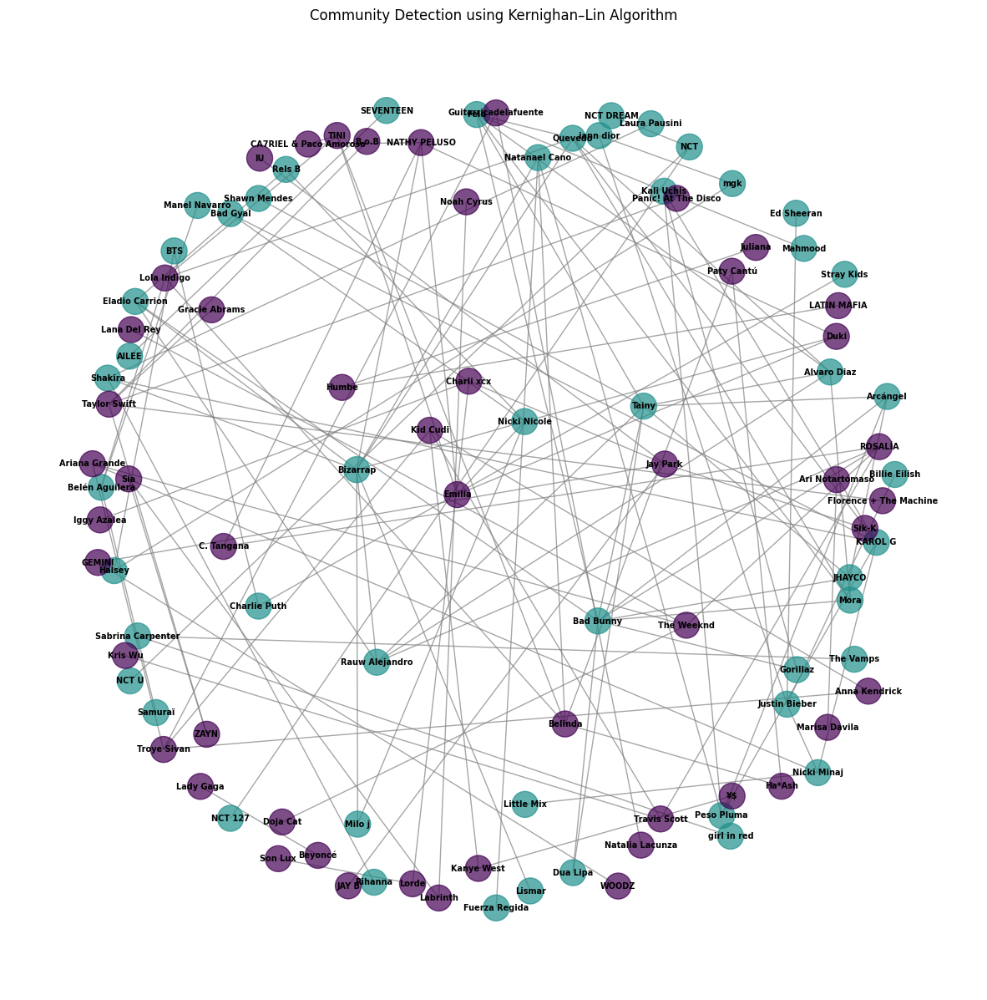

In [190]:
# Apply Kernighan–Lin algorithm for community detection
communities = kernighan_lin_bisection(G)

# Assign community labels
community_labels = {node: i for i, community in enumerate(communities) for node in community}

# Map community labels to colors
cmap = plt.colormaps['viridis']
node_colors = [cmap(community_labels[node] / 2) for node in G.nodes()]

# Calculate modularity
modularity_score = modularity(G, communities)
print(f"Modularity: {modularity_score}")

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Community Detection using Kernighan–Lin Algorithm")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

### Link Prediction Analysis
#### Jaccard Coefficient

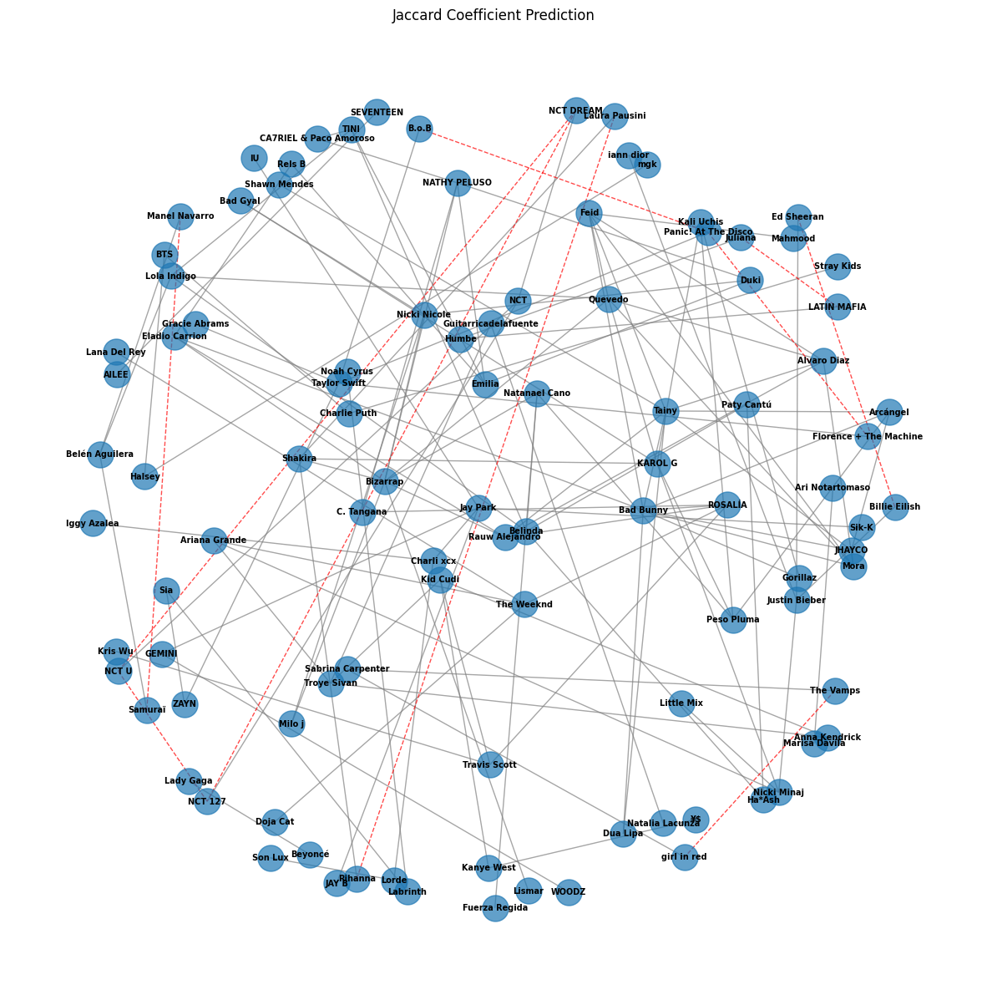

In [118]:
def jaccard_prediction(G, top_n=10):
  """
  Predicts potential new edges in a graph based on the Jaccard coefficient.

  Parameters:
  - G (nx.Graph): The graph for which predictions are to be made.
  - top_n (int): The number of top predictions to return.

  Returns:
  - list of tuple: Sorted list of predicted edges with their Jaccard coefficients.
  """
  # Compute Jaccard Coefficients for all non-existent edges in the graph
  preds = nx.jaccard_coefficient(G)
  # Sort predictions by Jaccard coefficient in descending order and take the top N
  return sorted(preds, key=lambda x: x[2], reverse=True)[:top_n]

# Get top 10 predicted edges
predicted_edges = jaccard_prediction(G)

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.

# Nodes
nx.draw_networkx_nodes(G, pos, node_size=500, alpha=0.7)  # Draw the nodes (artists) in sky blue.

# Original edges
nx.draw_networkx_edges(G, pos, edgelist=G.edges(), width=1.0, alpha=0.7, edge_color='gray')

# Add predicted edges with a different style
nx.draw_networkx_edges(G, pos, edgelist=[(u, v) for u, v, p in predicted_edges],
                       style='dashed', edge_color='red', width=1.0, alpha=0.7)  # Changed from 'dotted' to 'dashed' for compatibility

# Labels
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Jaccard Coefficient Prediction")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

In [119]:
# Print predicted edges and their Jaccard Scores
predicted_edges

[('Rihanna', 'Laura Pausini', 1.0),
 ('NCT U', 'NCT DREAM', 1.0),
 ('NCT U', 'NCT 127', 1.0),
 ('Juliana', 'LATIN MAFIA', 1.0),
 ('The Vamps', 'girl in red', 1.0),
 ('Samuraï', 'Manel Navarro', 1.0),
 ('Billie Eilish', 'Ed Sheeran', 1.0),
 ('NCT DREAM', 'NCT 127', 1.0),
 ('Panic! At The Disco', 'Florence + The Machine', 1.0),
 ('Panic! At The Disco', 'B.o.B', 1.0)]

#### Resource Allocation

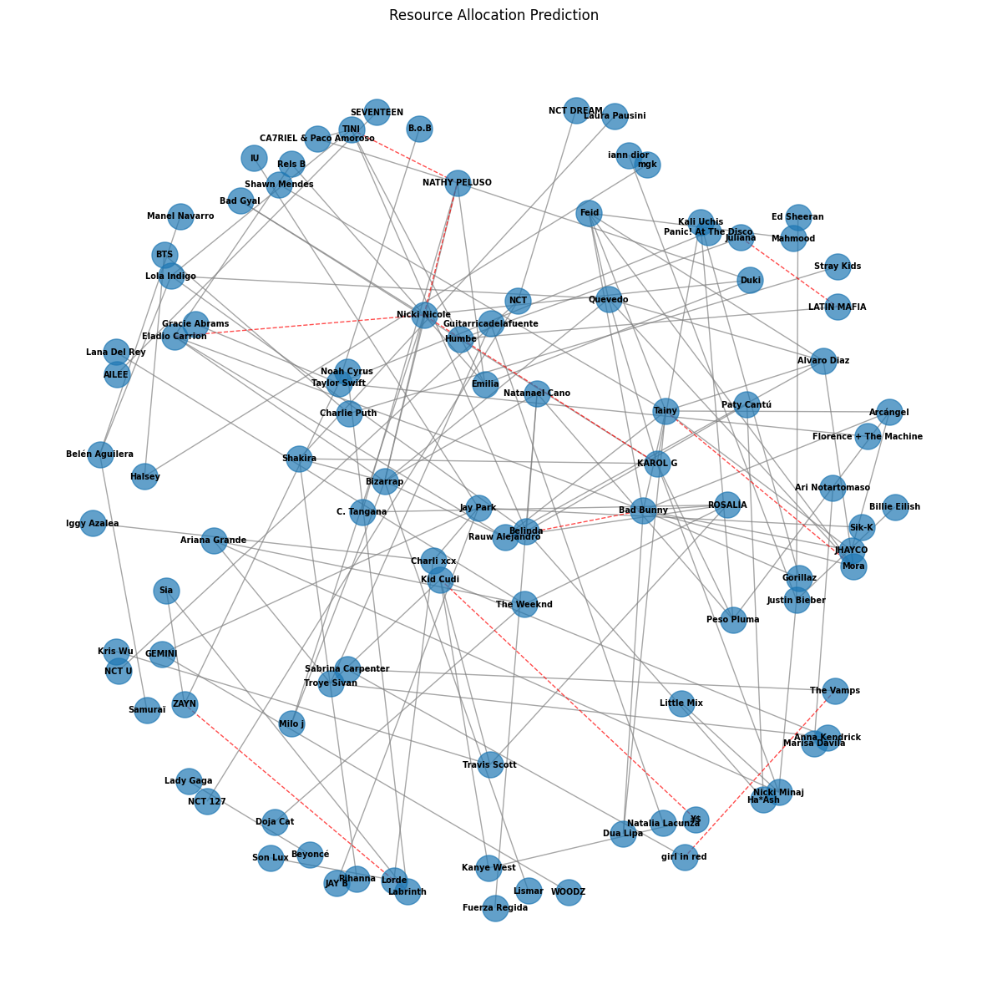

In [120]:
def resource_allocation_prediction(G, top_n=10):
  preds = nx.resource_allocation_index(G)
  # Sort predictions by Resource Allocation index in descending order and take the top N
  return sorted(preds, key=lambda x: x[2], reverse=True)[:top_n]

# Get top predictions based on Resource Allocation index
predicted_edges = resource_allocation_prediction(G)

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.

# Nodes
nx.draw_networkx_nodes(G, pos, node_size=500, alpha=0.7)  # Draw the nodes (artists) in sky blue.

# Original edges
nx.draw_networkx_edges(G, pos, edgelist=G.edges(), width=1.0, alpha=0.7, edge_color='gray')

# Add predicted edges with a different style
nx.draw_networkx_edges(G, pos, edgelist=[(u, v) for u, v, p in predicted_edges],
                       style='dashed', edge_color='red', width=1.0, alpha=0.7)  # Dashed edges in red for predicted connections

# Labels
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Resource Allocation Prediction")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

In [121]:
# Print predicted edges and their Resource Allocation index
predicted_edges

[('TINI', 'NATHY PELUSO', 0.75),
 ('Mora', 'Tainy', 0.7277777777777779),
 ('Nicki Nicole', 'NATHY PELUSO', 0.6944444444444444),
 ('Nicki Nicole', 'Eladio Carrion', 0.6111111111111112),
 ('Rauw Alejandro', 'Bad Bunny', 0.575),
 ('Labrinth', 'ZAYN', 0.5),
 ('KAROL G', 'Nicki Nicole', 0.5),
 ('Kid Cudi', '¥$', 0.5),
 ('Juliana', 'LATIN MAFIA', 0.5),
 ('The Vamps', 'girl in red', 0.5)]

#### Community Resource Allocation

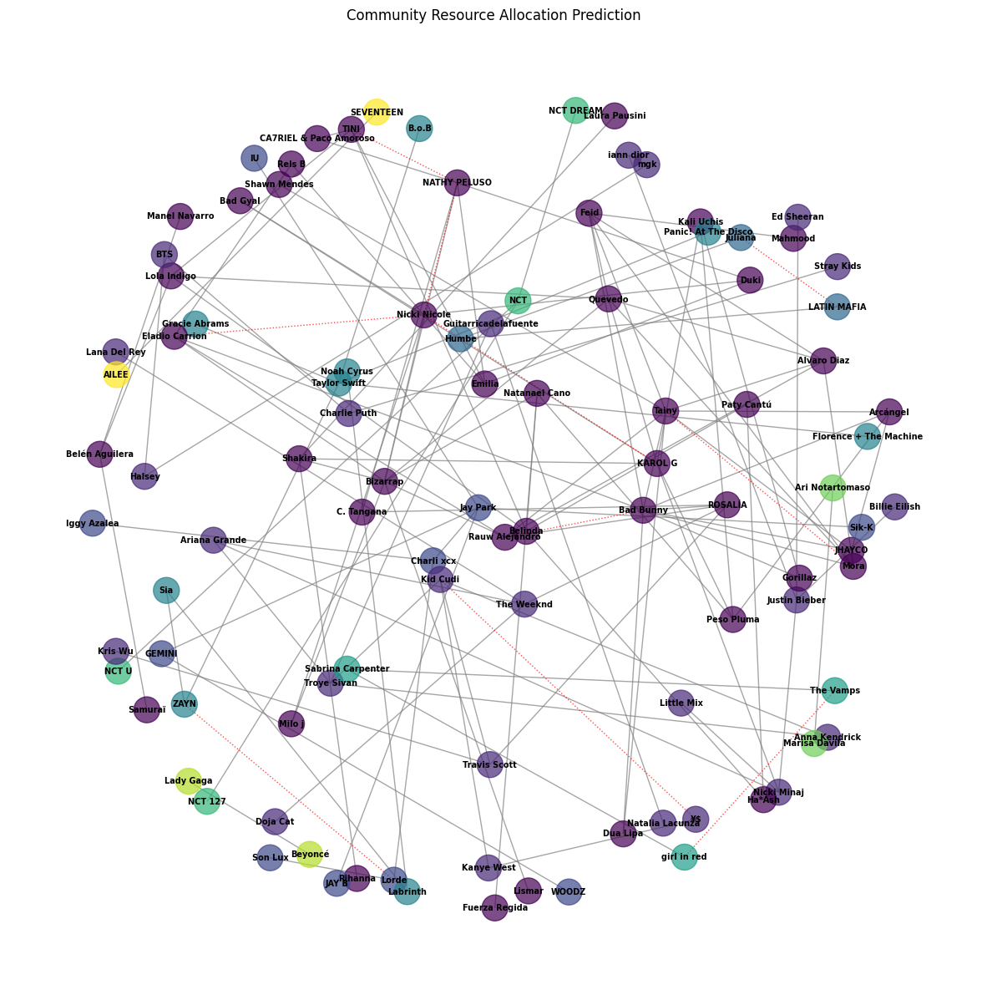

In [127]:
def girvan_newman_community(G):
  """
  Detects communities in a graph using the Girvan-Newman algorithm.

  Parameters:
  - G (nx.Graph): The graph to perform community detection on.

  Returns:
  - dict: A dictionary mapping each node to its community index.
  """
  comp = girvan_newman(G)
  communities = tuple(sorted(c) for c in next(comp))
  return {node: idx for idx, community in enumerate(communities) for node in community}

def community_resource_allocation(G, top_n=10):
  """
  Predicts new edges based on the Community Resource Allocation index.

  Parameters:
  - G (nx.Graph): The graph to analyze.
  - top_n (int): Number of top predictions to return.

  Returns:
  - list of tuple: Each tuple represents a predicted edge and its corresponding score.
  """
  scores = {}
  for u, v in nx.non_edges(G):
    community_u = G.nodes[u]['community']
    community_v = G.nodes[v]['community']
    if community_u == community_v:
      # Only consider nodes within the same community
      common_neighbors = set(G.neighbors(u)) & set(G.neighbors(v))
      score = sum(1 / G.degree(n) for n in common_neighbors if G.nodes[n]['community'] == community_u)
      scores[(u, v)] = score
  return sorted(scores.items(), key=lambda x: x[1], reverse=True)[:top_n]

# Detect communities using Girvan-Newman
partition = girvan_newman_community(G)
nx.set_node_attributes(G, partition, 'community')

predicted_edges = community_resource_allocation(G)

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.

# Nodes, colored by community
community_colors = [partition[node] for node in G]
nx.draw_networkx_nodes(G, pos, node_color=community_colors, cmap='viridis', node_size=500, alpha=0.7)

# Original edges
nx.draw_networkx_edges(G, pos, edgelist=G.edges(), width=1.0, alpha=0.7, edge_color='gray')

# Add predicted edges with a different style
predicted_edges = [(u, v) for (u, v), p in predicted_edges]
nx.draw_networkx_edges(G, pos, edgelist=predicted_edges, style='dotted', edge_color='red', width=1.0, alpha=0.7)

# Labels
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Community Resource Allocation Prediction")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

In [128]:
predicted_edges

[('TINI', 'NATHY PELUSO'),
 ('Mora', 'Tainy'),
 ('Nicki Nicole', 'NATHY PELUSO'),
 ('Nicki Nicole', 'Eladio Carrion'),
 ('Rauw Alejandro', 'Bad Bunny'),
 ('Labrinth', 'ZAYN'),
 ('KAROL G', 'Nicki Nicole'),
 ('Kid Cudi', '¥$'),
 ('Juliana', 'LATIN MAFIA'),
 ('The Vamps', 'girl in red')]

## Worldwide Top Artists
### Mapping the Network

In [201]:
# Define a function to fetch top artists from Spotify based on year and market.
def get_top_artists_country(year, market, total=200):
    artist_data = [] # Initialize an empty list to store artist information.
    limit = 50  # Set the maximum number of results per API call to 50.

     # Create a query string that includes the specified year.
    query = f'year:{year}'

    # Loop through the results in batches of 'limit' until reaching the 'total' number of artists.
    for offset in range(0, total, limit):
        # Call the Spotify search API with the year query, specifying artist type, market, and pagination.
        results = sp.search(q=query, type='artist', market=market, limit=limit, offset=offset)
        # Extract artist items from the API response.
        artists = results['artists']['items']

         # Loop through each artist in the current batch.
        for artist in artists:
             # Create a dictionary containing key details about each artist.
            artist_info = {
                'Name': artist['name'],
                'ID': artist['id'],
                'Popularity': artist['popularity'],
                'Genres': ', '.join(artist['genres']),
                'Followers': artist['followers']['total']
            }
            # Append the artist info to the list of artist data.
            artist_data.append(artist_info)

    # Return the collected artist data, limited to the number specified by 'total'.
    return artist_data[:total]

# Use the function to fetch the top artists in Mexico for the year 2024.
top_artists = get_top_artists_country(year=2024, market='MX')

# Convert the list of dictionaries into a DataFrame for better visualization and analysis.
df_top_artists = pd.DataFrame(top_artists)

# Display the DataFrame showing the top artists.
df_top_artists

,Name,ID,Popularity,Genres,Followers
0,KAROL G,790FomKkXshlbRYZFtlgla,91,"reggaeton, reggaeton colombiano, trap latino, ...",48690199
1,Ariana Grande,66CXWjxzNUsdJxJ2JdwvnR,91,pop,97945376
2,Billie Eilish,6qqNVTkY8uBg9cP3Jd7DAH,94,"art pop, pop",96654177
3,Rauw Alejandro,1mcTU81TzQhprhouKaTkpq,89,"puerto rican pop, reggaeton, trap latino, urba...",22412555
4,Lana Del Rey,00FQb4jTyendYWaN8pK0wa,91,"art pop, pop",37525788
...,...,...,...,...,...
195,Carlos Rivera,39yVoqm6sYFvvqF1RciUVf,72,"latin arena pop, latin pop, mexican pop, music...",4579466
196,Hombres G,60uh2KYYSCqAgJNxcU4DA0,71,"latin alternative, latin pop, mexican pop, roc...",4344886
197,Bunbury,4uqzzJg3ww5eH7IgGV7DMT,70,"latin alternative, latin rock, mexican rock, r...",2628699
198,Joel De La P,4qDRNT8ldCfCjSp9lBzYC5,70,corrido,161194


In [202]:
# Save the DataFrame
df_top_artists.to_csv('top_artists.csv', index=False)

In [203]:
# Use the function to find collaborations among the top artists.
collaborations = get_collaborations(df_top_artists, 'MX')

In [204]:
# Convert the list of collaborations into a DataFrame for better visualization and analysis.
df_collaborations = pd.DataFrame(collaborations)
df_collaborations

,Track Name,Artists,Track URL
0,QLONA,"Peso Pluma, KAROL G",https://open.spotify.com/track/5RqSsdzTNPX1uzk...
1,TQG,"Shakira, KAROL G",https://open.spotify.com/track/0DWdj2oZMBFSzRs...
2,CONTIGO (with Tiësto),"Tiësto, KAROL G",https://open.spotify.com/track/4UkUxO2WlKLc0Q1...
3,MAMIII,"Becky G, KAROL G",https://open.spotify.com/track/7FlQk2gJ6TBrHHi...
4,X SI VOLVEMOS,"Romeo Santos, KAROL G",https://open.spotify.com/track/4NoOME4Dhf4xgxb...
...,...,...,...
644,La Pelota,"Joel De La P, Luis R Conriquez",https://open.spotify.com/track/5dZ6SutInSiwz8B...
645,Una Corta,"Joel De La P, Luis R Conriquez",https://open.spotify.com/track/4HyHhhAw8HhC0Yj...
646,Te Quiero Así (En Vivo),"Joel De La P, Luis R Conriquez, Tito Double P",https://open.spotify.com/track/3T0c5gIYl2iGD2k...
647,Cabrón y Vago - En Vivo,"El Fantasma, Los Dos Carnales",https://open.spotify.com/track/4nbWX2HzrOEnX4x...


In [133]:
# Save the DataFrame
df_collaborations.to_csv('collaborations_top_artists.csv', index=False)

### Visualization of the Social Network

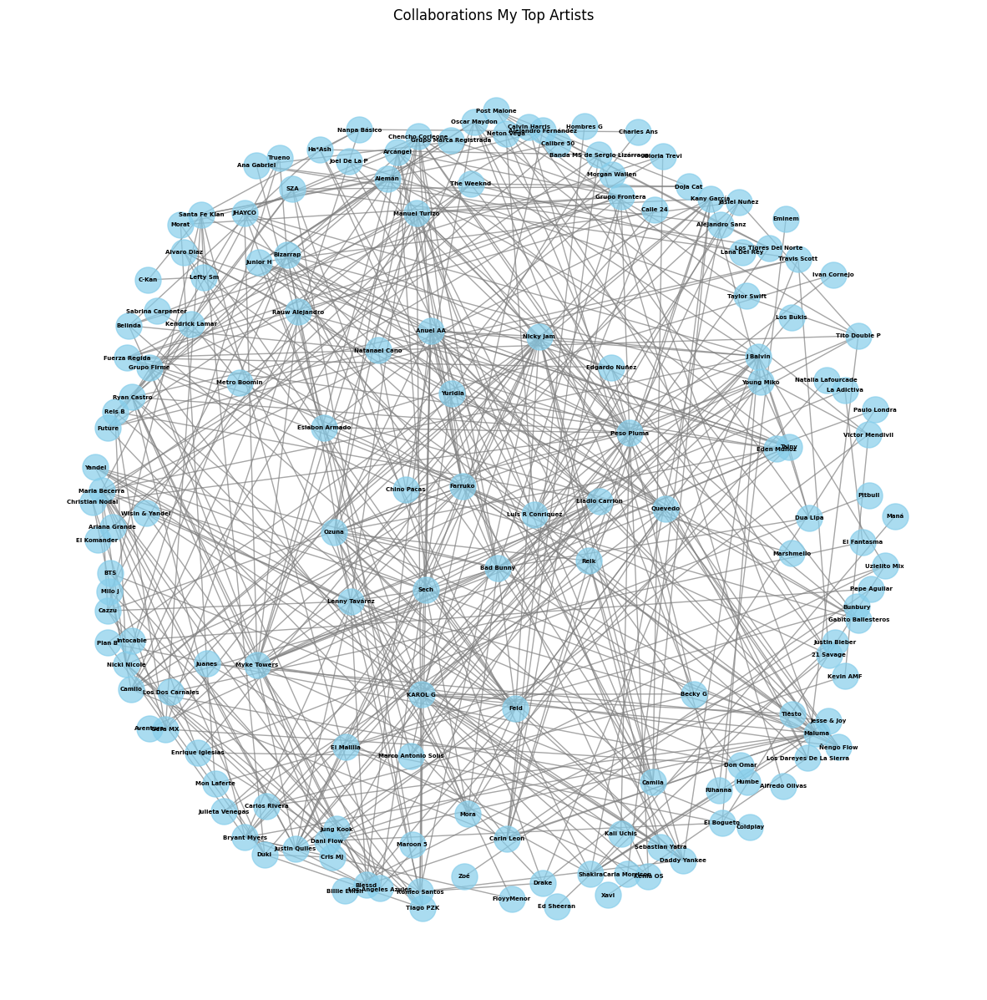

In [206]:
# Create and plot the graph based on the DataFrame 'df_collaborations'
G = create_collaboration_graph(df_collaborations)

### Basic Characteristics of the Network

In [135]:
# Determine the type of the graph
graph_type = {
    'is_bipartite': nx.is_bipartite(G),
    'is_directed': nx.is_directed(G),
    'is_undirected': not nx.is_directed(G),
    'is_planar': nx.check_planarity(G)[0]
}

# Print the results
for classification, result in graph_type.items():
    print(f"{classification}: {result}")

# Additional properties can be checked if needed
is_connected = nx.is_connected(G) if not nx.is_directed(G) else nx.is_weakly_connected(G)
print(f"is_connected: {is_connected}")

is_bipartite: False
is_directed: False
is_undirected: True
is_planar: False
is_connected: False


In [136]:
nx.average_clustering(G)

0.30540868982598124

In [208]:
# Check if the graph is connected
if nx.is_connected(G):
    # Calculate key network metrics if the graph is fully connected
    avg_path_length = nx.average_shortest_path_length(G)  # Average number of steps along the shortest paths for all possible pairs of network nodes
    clustering_coefficient = nx.average_clustering(G)  # Measure of the degree to which nodes in a graph tend to cluster together
    diameter = nx.diameter(G)  # The largest number of vertices that must be traversed in order to travel from one vertex to another
    eccentricity = nx.eccentricity(G)  # The maximum distance from a node to all other nodes in the graph
    radius = nx.radius(G)  # The minimum eccentricity among the vertices
    periphery = nx.periphery(G)  # Set of nodes that have eccentricity equal to the diameter
    center = nx.center(G)  # Set of nodes that have eccentricity equal to the radius
else:
    print('Graph is not connected, calculating metrics for largest connected component')
    # Calculate metrics for the largest connected component if the graph is not fully connected
    largest_cc = max(nx.connected_components(G), key=len)  # Find the largest connected component
    G_largest_cc = G.subgraph(largest_cc)  # Create a subgraph of G based on the largest connected component
    # Calculate metrics for the largest connected component
    avg_path_length = nx.average_shortest_path_length(G_largest_cc)
    clustering_coefficient = nx.average_clustering(G_largest_cc)
    diameter = nx.diameter(G_largest_cc)
    eccentricity = nx.eccentricity(G_largest_cc)
    radius = nx.radius(G_largest_cc)
    periphery = nx.periphery(G_largest_cc)
    center = nx.center(G_largest_cc)

# Retrieve the number of nodes and edges in the graph
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()

# Calculate the average distance across the graph (or its largest connected component if not fully connected)
avg_distance = nx.average_shortest_path_length(G_largest_cc) if not nx.is_connected(G) else avg_path_length

# Prepare a dictionary to store all the calculated network characteristics
network_characteristics = {
    'Number of nodes': num_nodes,
    'Number of edges': num_edges,
    'Average path length': avg_path_length,
    'Clustering coefficient': clustering_coefficient,
    'Diameter': diameter,
    'Eccentricity': eccentricity,
    'Radius': radius,
    'Periphery': periphery,
    'Center': center,
    'Average distance': avg_distance
}

# Print each characteristic with its calculated value
for characteristic, value in network_characteristics.items():
    print(f"{characteristic}: {value}")

Graph is not connected, calculating metrics for largest connected component
Number of nodes: 156
Number of edges: 465
Average path length: 3.767248322147651
Clustering coefficient: 0.3176250374190205
Diameter: 10
Eccentricity: {'Peso Pluma': 6, 'KAROL G': 5, 'Shakira': 6, 'Tiësto': 6, 'Becky G': 6, 'Romeo Santos': 6, 'The Weeknd': 9, 'Ariana Grande': 10, 'Rauw Alejandro': 7, 'Chencho Corleone': 7, 'Taylor Swift': 10, 'Post Malone': 9, 'Calle 24': 8, 'Fuerza Regida': 7, 'Chino Pacas': 7, 'Manuel Turizo': 6, 'Marshmello': 7, 'Natanael Cano': 7, 'Grupo Frontera': 7, 'Travis Scott': 8, 'Future': 8, 'Metro Boomin': 9, 'Ivan Cornejo': 7, 'Eslabon Armado': 7, 'Rels B': 8, 'Junior H': 7, 'Nicki Nicole': 7, 'Eladio Carrion': 7, 'Lana Del Rey': 10, '21 Savage': 8, 'Neton Vega': 7, 'Kenia OS': 7, 'Gabito Ballesteros': 7, 'Oscar Maydon': 7, 'Bad Bunny': 6, 'Myke Towers': 7, 'Feid': 6, 'J Balvin': 6, 'JHAYCO': 7, 'El Malilla': 7, 'Ha*Ash': 8, 'Young Miko': 6, 'Yandel': 6, 'Alvaro Diaz': 7, 'Ozuna':

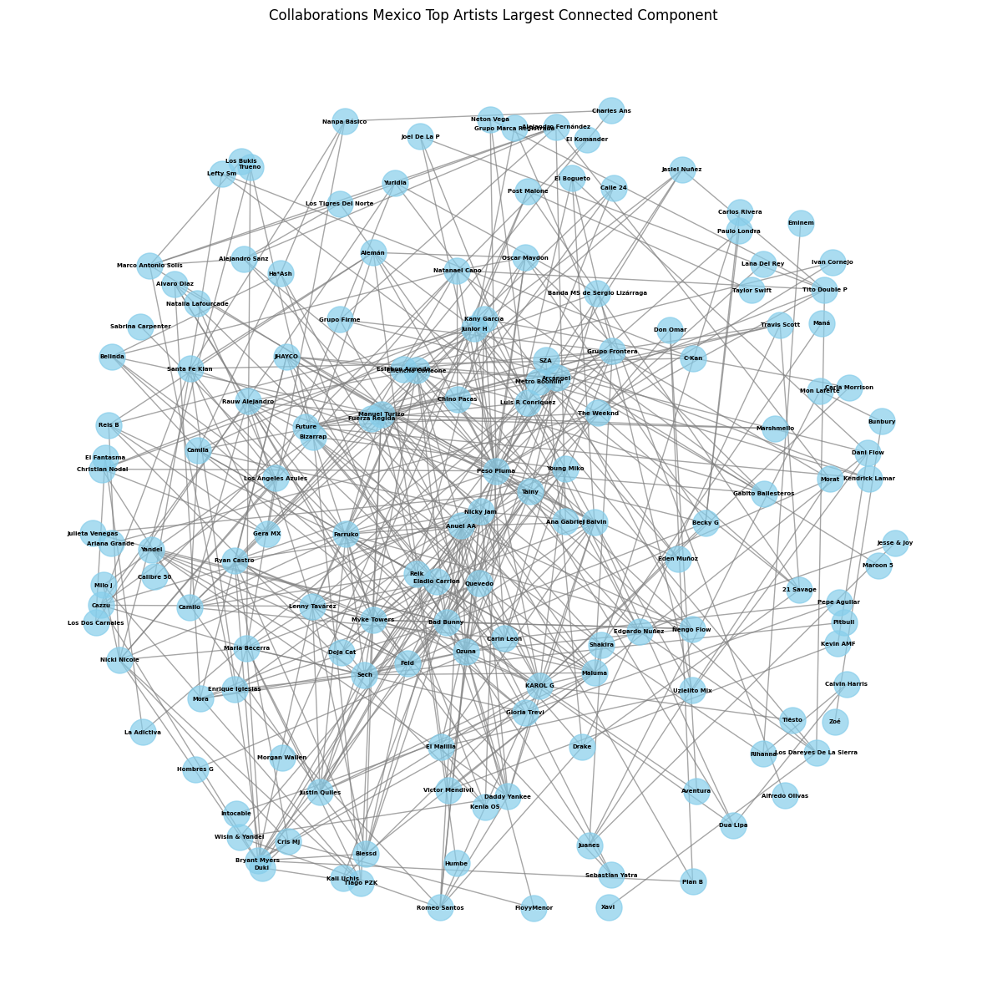

In [217]:
# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G_largest_cc, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G_largest_cc, pos, node_size=500, node_color='skyblue', alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G_largest_cc, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G_largest_cc, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Collaborations Mexico Top Artists Largest Connected Component")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()  # Display the plot.

In [139]:
# Determine the number of nodes and edges
num_nodes = G_largest_cc.number_of_nodes()
num_edges = G_largest_cc.number_of_edges()

# Print the results
print(f"Number of nodes: {num_nodes}")
print(f"Number of edges: {num_edges}")

Number of nodes: 150
Number of edges: 461


<ipython-input-210-6c8244e5f0f7>:23: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



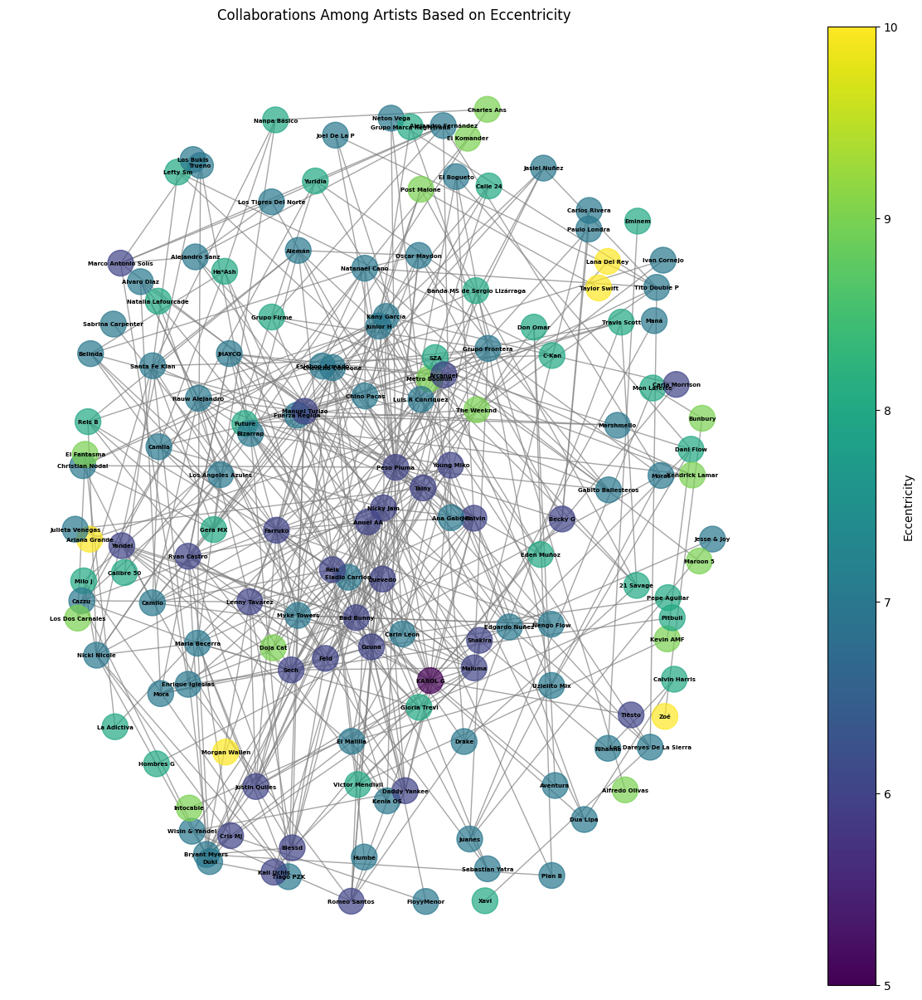

In [210]:
eccentricity = nx.eccentricity(G_largest_cc)

# Create a colormap
cmap = plt.colormaps['viridis']

# Normalize eccentricity for color mapping
norm = mcolors.Normalize(vmin=min(eccentricity.values()), vmax=max(eccentricity.values()))

# Get colors for each node based on eccentricity
node_colors = [cmap(norm(eccentricity[node])) for node in G_largest_cc.nodes()]

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G_largest_cc, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G_largest_cc, pos, node_size=500, node_color=node_colors, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G_largest_cc, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G_largest_cc, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Collaborations Among Artists Based on Eccentricity")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.colorbar(sm, label='Eccentricity')
plt.show()

<ipython-input-211-d679ff9122aa>:23: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



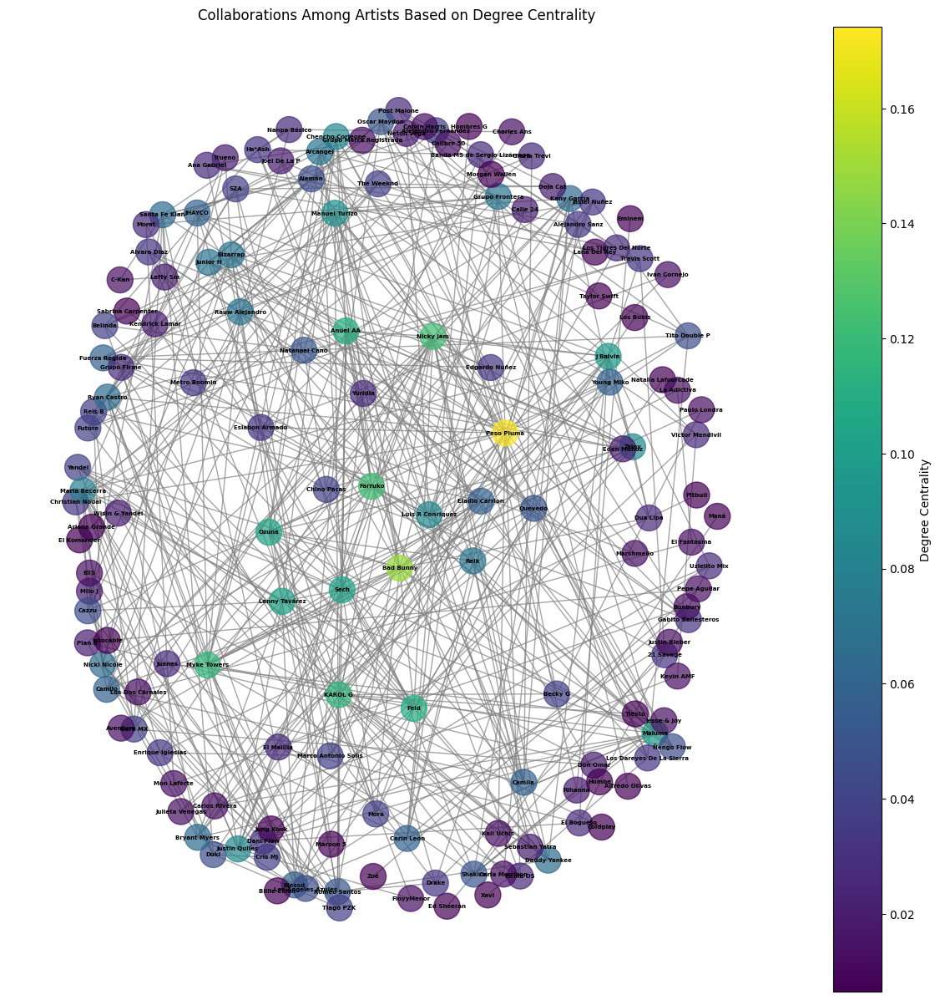

In [211]:
degree_centrality = nx.degree_centrality(G)

# Create a colormap
cmap = plt.colormaps['viridis']

# Normalize eccentricity for color mapping
norm = mcolors.Normalize(vmin=min(degree_centrality.values()), vmax=max(degree_centrality.values()))

# Get colors for each node based on eccentricity
node_colors = [cmap(norm(degree_centrality[node])) for node in G.nodes()]

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Collaborations Among Artists Based on Degree Centrality")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.colorbar(sm, label='Degree Centrality')
plt.show()

In [142]:
# Convert the degree centrality dictionary to a pandas DataFrame
degree_centrality_df = pd.DataFrame.from_dict(degree_centrality, orient='index', columns=['Degree Centrality'])

# Sort the DataFrame by Degree Centrality in descending order
degree_centrality_df = degree_centrality_df.sort_values(by='Degree Centrality', ascending=False)

# Select the top N nodes based on Degree Centrality
top_n = 10  # Change this value to select a different number of top nodes
most_important_nodes = degree_centrality_df.head(top_n)
most_important_nodes

,Degree Centrality
Peso Pluma,0.174194
Bad Bunny,0.148387
Farruko,0.122581
Nicky Jam,0.122581
KAROL G,0.116129
Myke Towers,0.116129
Anuel AA,0.109677
Feid,0.109677
Sech,0.103226
Ozuna,0.103226


In [143]:
# Calculate the average degree centrality
average_degree_centrality = degree_centrality_df['Degree Centrality'].mean()
average_degree_centrality

0.03846153846153846

<ipython-input-212-f6e32062dd78>:23: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



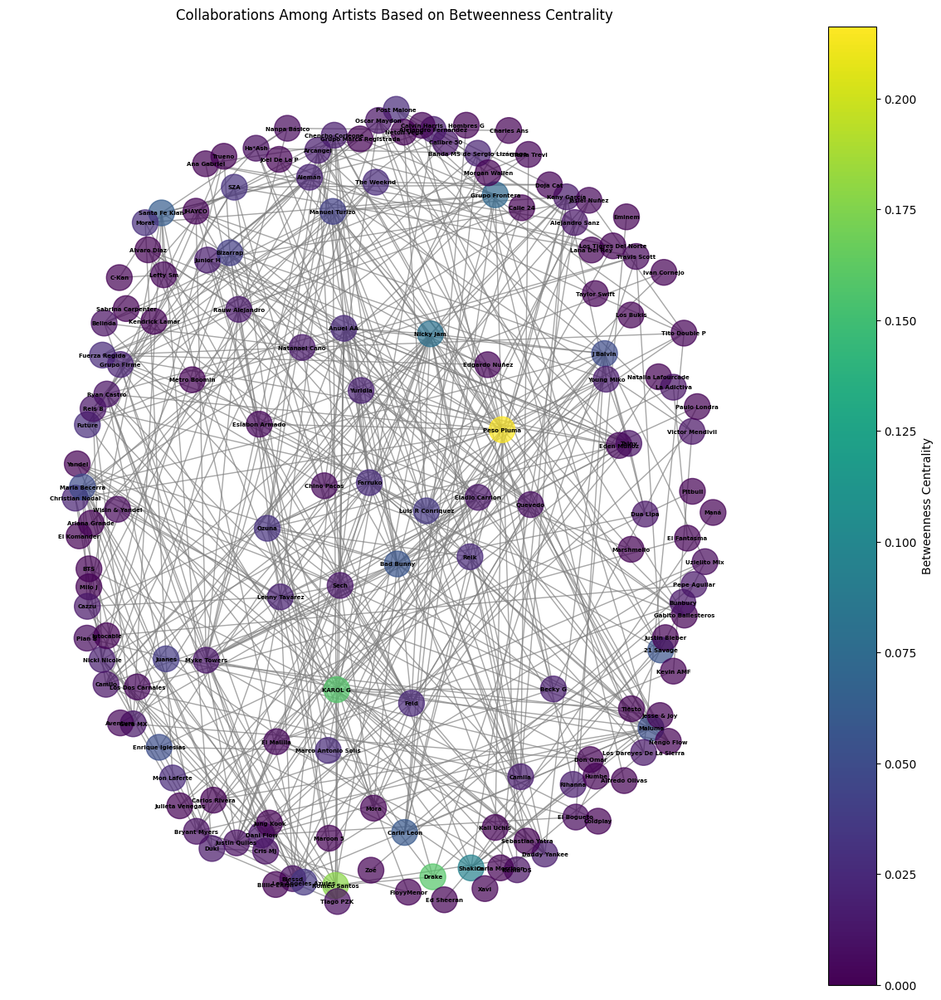

In [212]:
betweenness_centrality = nx.betweenness_centrality(G)

# Create a colormap
cmap = plt.colormaps['viridis']

# Normalize eccentricity for color mapping
norm = mcolors.Normalize(vmin=min(betweenness_centrality.values()), vmax=max(betweenness_centrality.values()))

# Get colors for each node based on eccentricity
node_colors = [cmap(norm(betweenness_centrality[node])) for node in G.nodes()]

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1.5, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Collaborations Among Artists Based on Betweenness Centrality")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
plt.colorbar(sm, label='Betweenness Centrality')
plt.show()

In [145]:
# Convert the degree centrality dictionary to a pandas DataFrame
betweenness_centrality_df = pd.DataFrame.from_dict(betweenness_centrality, orient='index', columns=['Betweenness Centrality'])

# Sort the DataFrame by Degree Centrality in descending order
betweenness_centrality_df = betweenness_centrality_df.sort_values(by='Betweenness Centrality', ascending=False)

# Select the top N nodes based on Degree Centrality
top_n = 10  # Change this value to select a different number of top nodes
most_important_nodes = betweenness_centrality_df.head(top_n)
most_important_nodes

,Betweenness Centrality
Peso Pluma,0.216322
Romeo Santos,0.177640
Drake,0.158504
KAROL G,0.157239
Shakira,0.095618
Nicky Jam,0.080591
Grupo Frontera,0.071827
Santa Fe Klan,0.062572
Carin Leon,0.059150
Bad Bunny,0.056872


In [146]:
# Calculate the average degree centrality
average_betweenness_centrality = betweenness_centrality_df['Betweenness Centrality'].mean()
average_betweenness_centrality

0.016610271448981126

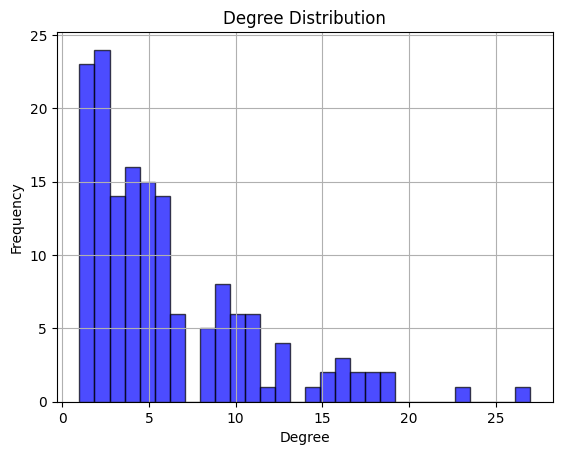

In [147]:
# Calculate the degree of each node
degrees = dict(G.degree())

# Extract degree values
degree_values = list(degrees.values())

# Plotting the histogram of node degrees
plt.hist(degree_values, bins=30, alpha=0.7, color='blue', edgecolor='black')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.title('Degree Distribution')
plt.grid(True)
plt.show()

Modularity: 0.12144525378656483


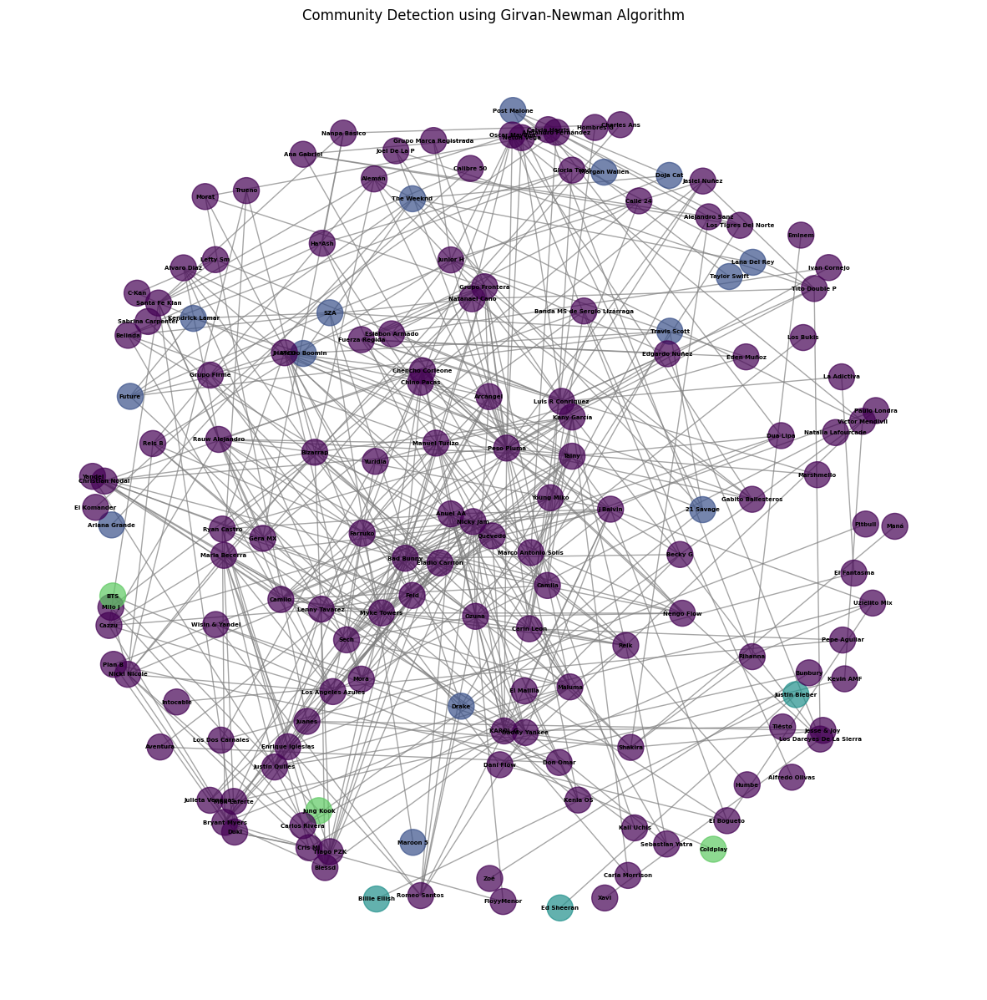

In [215]:
# Use the Girvan-Newman algorithm to detect communities
comp = girvan_newman(G)
# Select the first level of community divisions
communities = next(comp)
communities = [list(community) for community in communities]

# Evaluate the community detection using modularity
modularity_value = modularity(G, communities)

# Print the modularity value
print(f"Modularity: {modularity_value}")

# Create a colormap
cmap = plt.colormaps['viridis']
colors = [cmap(i / len(communities)) for i in range(len(communities))]

# Assign colors to nodes based on their community
color_map = []
for node in G:
    for i, community in enumerate(communities):
        if node in community:
            color_map.append(colors[i % len(colors)])

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G, pos, node_size=500, node_color=color_map, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Community Detection using Girvan-Newman Algorithm")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

Modularity: 0.3735460746907156


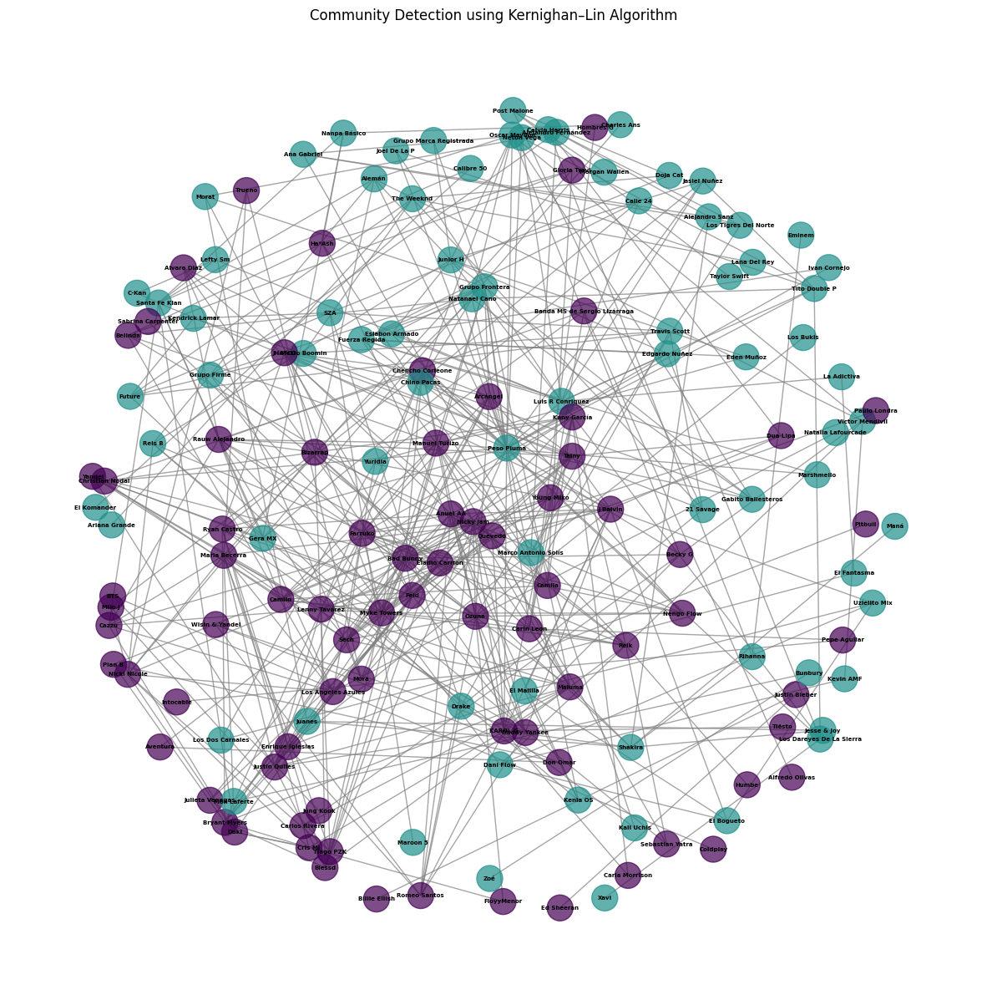

In [216]:
# Apply Kernighan–Lin algorithm for community detection
communities = kernighan_lin_bisection(G)

# Assign community labels
community_labels = {node: i for i, community in enumerate(communities) for node in community}

# Map community labels to colors
cmap = plt.colormaps['viridis']
node_colors = [cmap(community_labels[node] / 2) for node in G.nodes()]

# Calculate modularity
modularity_score = modularity(G, communities)
print(f"Modularity: {modularity_score}")

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.
nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors, alpha=0.7)  # Draw the nodes (artists) in sky blue.
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.7, edge_color='gray')  # Draw the edges (collaborations) in gray.
nx.draw_networkx_labels(G, pos, font_size=5, font_weight='bold')  # Label the nodes with artist names.

plt.title("Community Detection using Kernighan–Lin Algorithm")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

### Link Prediction Analysis
#### Jaccard Coefficient

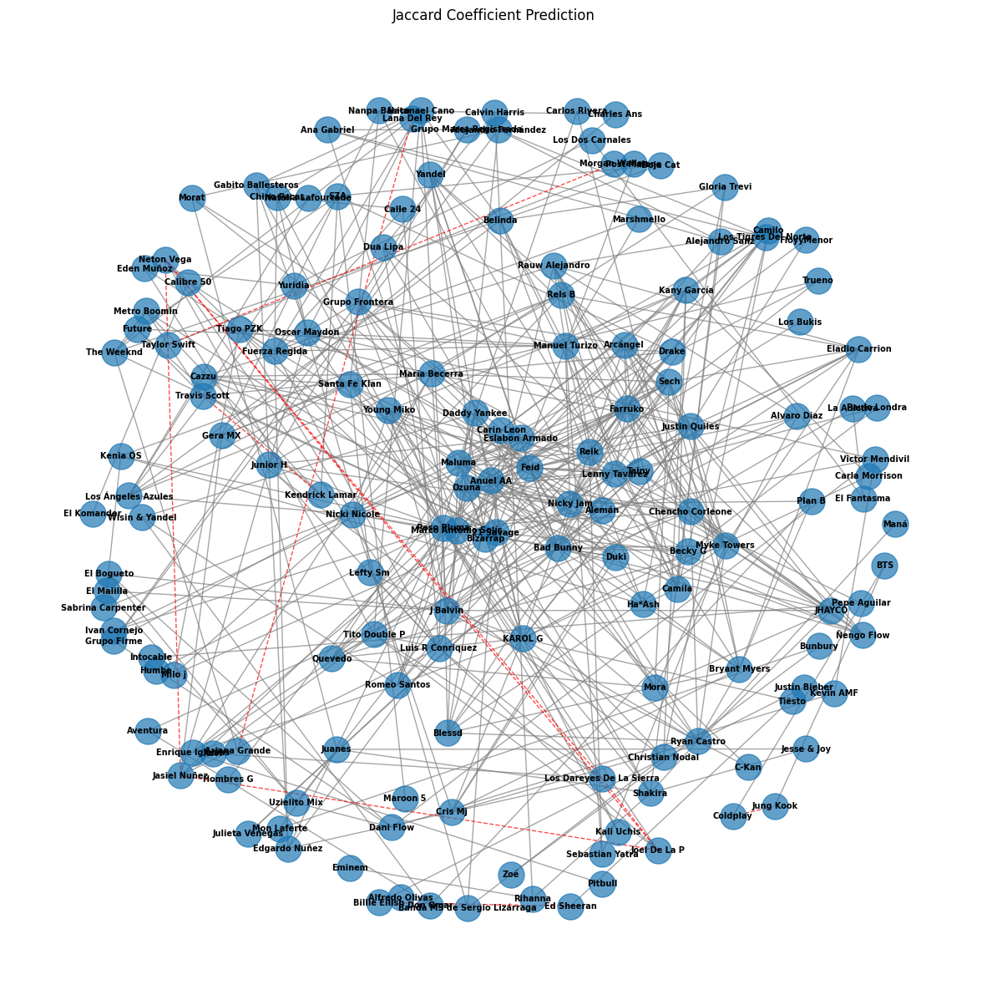

In [150]:
# Get top 10 predicted edges
predicted_edges = jaccard_prediction(G)

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.

# Nodes
nx.draw_networkx_nodes(G, pos, node_size=500, alpha=0.7)  # Draw the nodes (artists) in sky blue.

# Original edges
nx.draw_networkx_edges(G, pos, edgelist=G.edges(), width=1.0, alpha=0.7, edge_color='gray')

# Add predicted edges with a different style
nx.draw_networkx_edges(G, pos, edgelist=[(u, v) for u, v, p in predicted_edges],
                       style='dashed', edge_color='red', width=1.0, alpha=0.7)  # Changed from 'dotted' to 'dashed' for compatibility

# Labels
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Jaccard Coefficient Prediction")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

In [151]:
# Print predicted edges and their Jaccard Scores
predicted_edges

[('Billie Eilish', 'Ed Sheeran', 1.0),
 ('Taylor Swift', 'Morgan Wallen', 1.0),
 ('Ariana Grande', 'Lana Del Rey', 1.0),
 ('Joel De La P', 'Neton Vega', 1.0),
 ('Coldplay', 'Jung Kook', 1.0),
 ('Joel De La P', 'Jasiel Nuñez', 0.6),
 ('Joel De La P', 'Los Dareyes De La Sierra', 0.6),
 ('Jasiel Nuñez', 'Neton Vega', 0.6),
 ('Los Dareyes De La Sierra', 'Neton Vega', 0.6),
 ('Kendrick Lamar', 'Travis Scott', 0.6)]

#### Resource Allocation

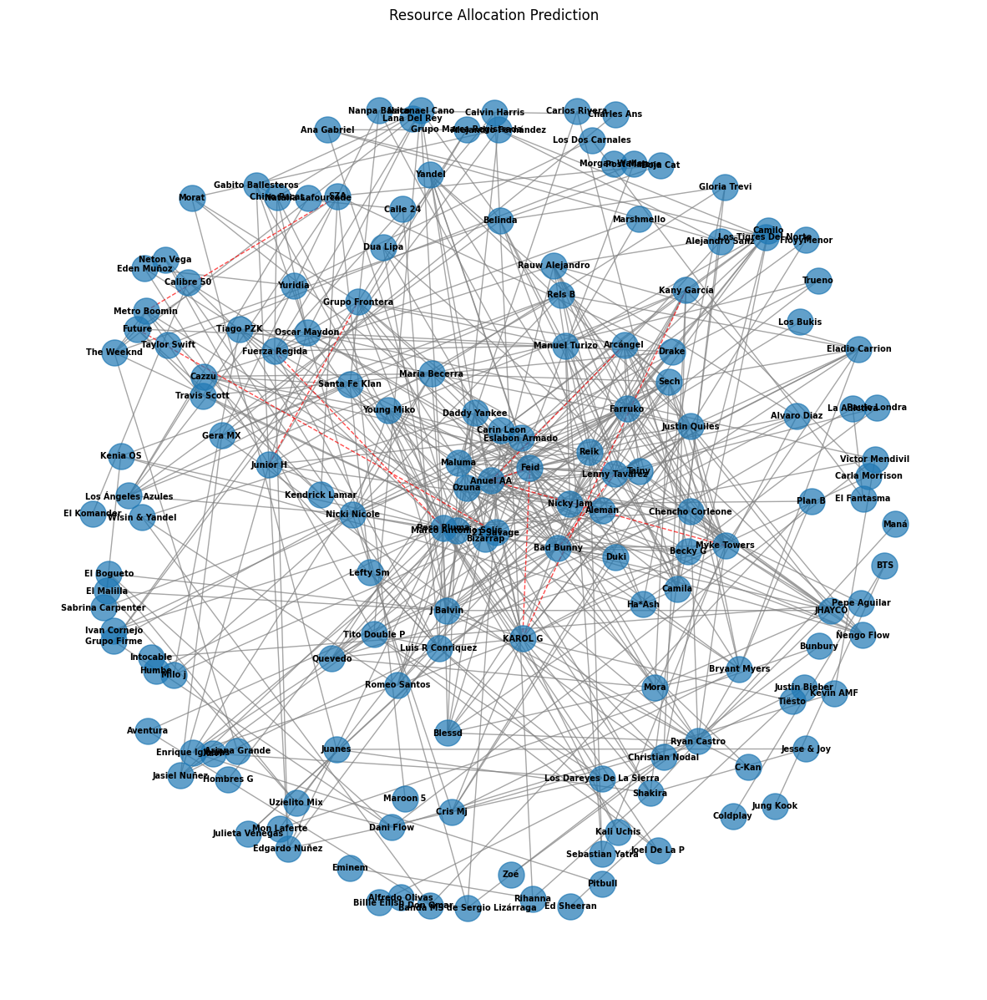

In [152]:
# Get top predictions based on Resource Allocation index
predicted_edges = resource_allocation_prediction(G)

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.

# Nodes
nx.draw_networkx_nodes(G, pos, node_size=500, alpha=0.7)  # Draw the nodes (artists) in sky blue.

# Original edges
nx.draw_networkx_edges(G, pos, edgelist=G.edges(), width=1.0, alpha=0.7, edge_color='gray')

# Add predicted edges with a different style
nx.draw_networkx_edges(G, pos, edgelist=[(u, v) for u, v, p in predicted_edges],
                       style='dashed', edge_color='red', width=1.0, alpha=0.7)  # Dashed edges in red for predicted connections

# Labels
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Resource Allocation Prediction")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

In [153]:
# Print predicted edges and their Resource Allocation index
predicted_edges

[('Myke Towers', 'Anuel AA', 0.9025353587424524),
 ('Future', '21 Savage', 0.7666666666666666),
 ('Junior H', 'Grupo Frontera', 0.737037037037037),
 ('Feid', 'Anuel AA', 0.7341440278511216),
 ('Metro Boomin', 'SZA', 0.7),
 ('Lenny Tavárez', 'Bad Bunny', 0.6842115186155433),
 ('KAROL G', 'Kany García', 0.6637426900584795),
 ('Peso Pluma', 'Fuerza Regida', 0.6594988344988345),
 ('Anuel AA', 'Arcángel', 0.6289242476313415),
 ('KAROL G', 'Feid', 0.6281657669815565)]

### Community Resource Allocation

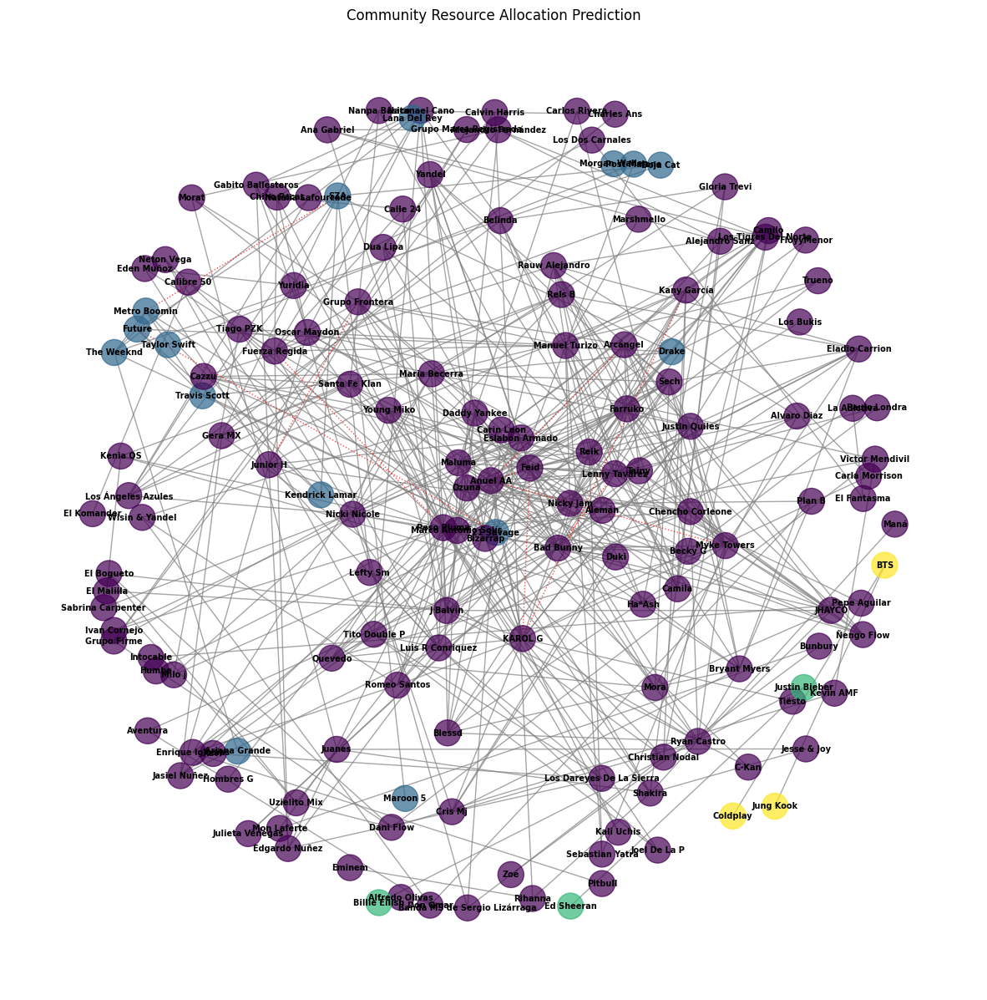

In [154]:
# Detect communities using Girvan-Newman
partition = girvan_newman_community(G)
nx.set_node_attributes(G, partition, 'community')

predicted_edges = community_resource_allocation(G)

# Plot the graph using matplotlib.
plt.figure(figsize=(15, 15))  # Set the size of the plot.
pos = nx.spring_layout(G, k=1, seed=25)  # Position nodes using the spring layout algorithm, which helps visualize the graph clearly.

# Nodes, colored by community
community_colors = [partition[node] for node in G]
nx.draw_networkx_nodes(G, pos, node_color=community_colors, cmap='viridis', node_size=500, alpha=0.7)

# Original edges
nx.draw_networkx_edges(G, pos, edgelist=G.edges(), width=1.0, alpha=0.7, edge_color='gray')

# Add predicted edges with a different style
predicted_edges = [(u, v) for (u, v), p in predicted_edges]
nx.draw_networkx_edges(G, pos, edgelist=predicted_edges, style='dotted', edge_color='red', width=1.0, alpha=0.7)

# Labels
nx.draw_networkx_labels(G, pos, font_size=7, font_weight='bold')  # Label the nodes with artist names.

plt.title("Community Resource Allocation Prediction")  # Set the title of the plot.
plt.axis('off')  # Turn off the axis since they are not relevant in this context.
plt.show()

In [155]:
predicted_edges

[('Myke Towers', 'Anuel AA'),
 ('Future', '21 Savage'),
 ('Junior H', 'Grupo Frontera'),
 ('Feid', 'Anuel AA'),
 ('Metro Boomin', 'SZA'),
 ('Lenny Tavárez', 'Bad Bunny'),
 ('KAROL G', 'Kany García'),
 ('Peso Pluma', 'Fuerza Regida'),
 ('Anuel AA', 'Arcángel'),
 ('KAROL G', 'Feid')]